In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 

from sklearn.feature_extraction.text import CountVectorizer

count=CountVectorizer()
data=pd.read_csv("Train.csv")
data.head()

,text,label
0,I grew up (b. 1965) watching and loving the Th...,0
1,"When I put this movie in my DVD player, and sa...",0
2,Why do people who do not know what a particula...,0
3,Even though I have great interest in Biblical ...,0
4,Im a die hard Dads Army fan and nothing will e...,1


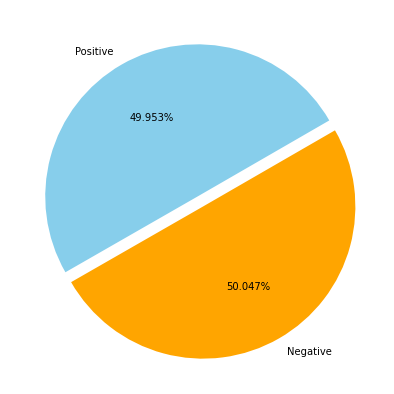

In [4]:
fig=plt.figure(figsize=(7,7))
colors=['skyblue','orange']
pos=data[data['label']==1]
neg=data[data['label']==0]
ck=[pos['label'].count(),neg['label'].count()]
legpie=plt.pie(ck,labels=["Positive","Negative"],
                 autopct ='%0.3f%%',
                 colors = colors,
                 startangle = 30,
                 explode=(0, 0.075))

In [5]:
import re
def preprocessor(text):
    text=re.sub('<[^>]*>','',text) #substituting HTML tags if present in the text with blank expression
    emojis=re.findall('(?::|;|=)(?:-)?(?:\)|\(|D|P)',text) #storing all forms of text emojis into a list
    text=re.sub('[\W]+',' ',text.lower()) +' '.join(emojis).replace('-','')
    return text   

data['text']=data['text'].apply(preprocessor)

In [7]:
from nltk.stem.porter import PorterStemmer
ps=PorterStemmer() # Using Porter Stemmer algorithm to simplify the data and remove unnecessary complexities

def tokenizer_porter(text):
    return [ps.stem(word) for word in text.split()]

In [8]:
import nltk
nltk.download('stopwords')

from nltk.corpus import stopwords
stop=stopwords.words('english')

positivedata = data[ data['label'] == 1]
positivedata =positivedata['text']
negdata = data[data['label'] == 0]
negdata= negdata['text']

[nltk_data] Downloading package stopwords to /home/ritam/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [29]:
review = []

stopwords_set = set(stopwords.words("english"))

for index, row in data.iterrows():
    words_filtered = [e.lower() for e in row.text.split() if len(e) >= 3]
    words_cleaned = [word for word in words_filtered
        if 'http' not in word
        and not word.startswith('@')
        and not word.startswith('#')
        and word != 'RT']
    words_without_stopwords = [word for word in words_cleaned if not word in stopwords_set]
    review.append((words_without_stopwords, row.label))

In [10]:
from wordcloud import WordCloud

def wordcloud_draw(data, color = 'white'):
    words = ' '.join(data)
    cleaned_word = " ".join([word for word in words.split()
                              if(word!='movie' and word!='film')
                            ])
    wordcloud = WordCloud(stopwords=stop,
                      background_color=color,
                      width=2500,
                      height=2000
                     ).generate(cleaned_word)
    plt.figure(1,figsize=(10, 7))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()

Positive words are as follows


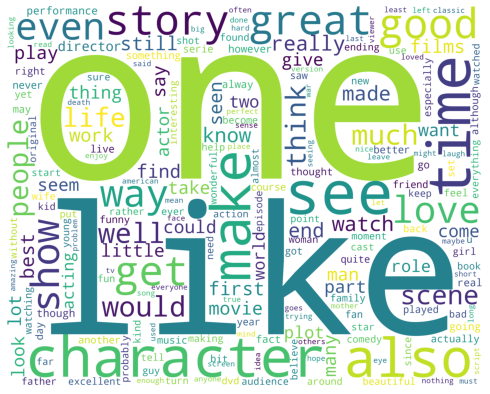

Negative words are as follows


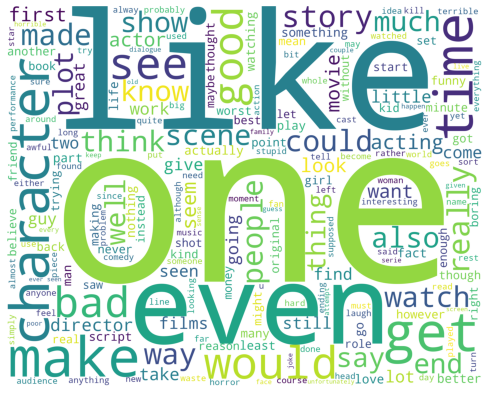

In [11]:
print("Positive words are as follows")
wordcloud_draw(positivedata,'white')
print("Negative words are as follows")
wordcloud_draw(negdata)

In [31]:
print(review[6])

(['finally', 'watched', 'shocking', 'movie', 'last', 'night', 'disturbing', 'mindf', 'ker', 'unbelievably', 'bloody', 'unforgettable', 'scenes', 'total', 'assault', 'senses', 'looks', 'like', 'movie', 'minds', 'lynch', 'specifically', 'eraserhead', 'buttgereit', 'even', 'little', 'begotten', 'guy', 'pregnant', 'sister', 'beyond', 'belief', 'really', 'happen', 'brain', 'left', 'right', 'sides', 'battle', 'main', 'theme', 'piece', 'art', 'draw', 'fine', 'line', 'fantasy', 'reality', 'would', 'happen', 'right', 'side', 'brain', 'dreams', 'fantasizes', 'overtakes', 'reasoning', 'logical', 'left', 'side', 'music', 'movie', 'unbelievable', 'kind', 'electronic', 'score', 'absolutely', 'perfect', 'even', 'though', 'movie', 'totally', 'shocking', 'pretty', 'disgusting', 'extreme', 'scenes', 'including', 'hard', 'core', 'sex', 'ever', 'see', 'movie', 'viewed', 'work', 'art', 'loved', 'music', 'still', 'amazes', 'try', 'find', 'soundtrack', 'available', 'watching', 'subconscious', 'cruelty', 'rea

In [32]:
from sklearn.feature_extraction.text import TfidfVectorizer

#The use of the above library is to score the relative importance of the words

tfidf=TfidfVectorizer(strip_accents=None,lowercase=False,preprocessor=None,tokenizer=tokenizer_porter,use_idf=True,norm='l2',smooth_idf=True)
y=data.label.values
x=tfidf.fit_transform(data.text)

In [15]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(x,y,random_state=1,test_size=0.5,shuffle=False)

In [16]:
from sklearn.linear_model import LogisticRegressionCV
clf=LogisticRegressionCV(cv=6,scoring='accuracy',random_state=0,n_jobs=-1,verbose=3,max_iter=500).fit(X_train,y_train)
y_pred = clf.predict(X_test)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.15527D+04    |proj g|=  7.83076D+01


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in this segment
Piece      1 --f1, f2 at start point  -1.0507D+05  1.0507D+05
Distance to the stationary point =   1.0000D+00

---------------- exit CAUCHY----------------------

       66596  variables are free at GCP            1
 LINE SEARCH           1  times; norm of step =   3.22488505989133104E-002

At iterate    1    f=  1.15475D+04    |proj g|=  3.05247D+00


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.76675351284258798E-004

At iterate    2    f=  1.15475D+04    |proj g|=  2.23504D+00


ITERATION     3

--------

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



06  0.0000D+00 -6.9472D-06
      1.6043D-05  7.8694D-04 -3.6343D-06  3.3181D-05  0.0000D+00  1.6630D-05
      1.5778D-06  7.7825D-06  7.0630D-05  0.0000D+00  1.7469D-05  9.7910D-06
      1.3491D-04  0.0000D+00  0.0000D+00  7.8615D-06  5.4098D-05  0.0000D+00
     -1.0014D-05  1.3922D-05  7.4010D-06 -6.7111D-05  0.0000D+00  0.0000D+00
      8.9005D-07  0.0000D+00  6.3783D-06  1.2279D-05  0.0000D+00  0.0000D+00
      6.5797D-06  3.7655D-06 -1.0126D-05  5.6338D-06  0.0000D+00  2.7899D-04
      9.5573D-06  1.7110D-05  1.7283D-05  1.1415D-05 -5.4471D-06  0.0000D+00
     -3.4838D-05  0.0000D+00 -7.6867D-06  7.1071D-05  2.3611D-06  0.0000D+00
      2.5050D-05 -1.0307D-05  5.3188D-06  0.0000D+00  3.0798D-06  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      5.9794D-06  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  5.4919D-06  0.0000D+00  4.9036D-06
      8.7846D-06  0.0000D+00  0.0000D+00 -5.3743D

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3 -4.1746D-04 -1.7866D-04
      3.1853D-04  0.0000D+00  2.8525D-04  4.9783D-04  0.0000D+00  0.0000D+00
      3.4473D-04 -3.6301D-03  8.9762D-04  5.2313D-04  0.0000D+00 -3.6089D-04
      0.0000D+00  2.6527D-03  1.3172D-03  0.0000D+00  5.8090D-03 -2.2320D-04
     -4.2484D-04 -6.3422D-04  7.3730D-04  0.0000D+00  5.2389D-04 -2.4395D-03
     -6.6023D-04  1.3080D-03  1.3903D-04  0.0000D+00  0.0000D+00 -6.5507D-04
     -6.8825D-04  1.3389D-03  0.0000D+00  0.0000D+00 -1.8282D-04 -5.5250D-04
     -1.1777D-03  2.5204D-03  0.0000D+00  0.0000D+00  0.0000D+00 -2.4828D-04
      0.0000D+00  3.7686D-04  0.0000D+00  2.6411D-04  0.0000D+00  0.0000D+00
      0.0000D+00 -6.2100D-04  0.0000D+00 -1.2291D-03  1.0193D-02  0.0000D+00
     -5.2556D-04 -1.1416D-03  0.0000D+00  0.0000D+00  0.0000D+00  6.9058D-04
      0.0000D+00  0.0000D+00  4.3024D-04  0.0000D+00  0.0000D+00  4.9028D-04
      6.4812D-04  1.9938D-03  0.0000D+00  0.0000D+00  5.8743D-04  1.7683D-04
      2.0787D-04  0.0000D+00  0.0000D+00  2.1967D-

  F =   11269.926358463927     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.10453D+04    |proj g|=  6.18673D+01


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in this segment
Piece      1 --f1, f2 at start point  -6.5270D+04  6.5270D+04
Distance to the stationary point =   1.0000D+00

---------------- exit CAUCHY----------------------

       66596  variables are free at GCP            1
 LINE SEARCH           0  times; norm of step =   0.99999999999999989     

At iterate    1    f=  1.08136D+04    |proj g|=  2.05600D+02


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    4.0522109116111364 

     -2.3501D-03  0.0000D+00  0.0000D+00 -4.2680D-02  2.4920D-03  5.1523D-03
      0.0000D+00  0.0000D+00  3.5973D-04  0.0000D+00  6.7014D-03 -7.5899D-05
     -3.6325D-03  2.6012D-02 -8.3112D-03  2.7299D-03  0.0000D+00 -3.1228D-03
     -1.5914D-03  1.9762D-03  2.7024D-03 -1.1992D-03  3.7313D-03  0.0000D+00
      1.5283D-02  4.5640D-03  4.5486D-03  1.4262D-02 -2.7448D-03 -8.8284D-03
      0.0000D+00  1.2624D-02  0.0000D+00  1.7646D-03  0.0000D+00 -1.7570D-02
      2.1597D-03 -2.8533D-02 -3.1026D-03  0.0000D+00  4.9577D-03  8.4243D-03
      1.9921D-03  4.6447D-03  0.0000D+00  4.3639D-03 -1.3635D-04 -4.6641D-03
     -1.5746D-03  0.0000D+00 -2.9852D-03 -1.1974D-03 -2.5399D-02  0.0000D+00
      0.0000D+00 -5.3674D-03 -1.9726D-03 -6.6039D-04  5.6344D-03  5.6104D-03
      0.0000D+00 -1.2771D-02  9.7372D-04  5.7038D-03 -9.0509D-03  1.4970D-02
      0.0000D+00 -8.0389D-03  0.0000D+00  1.8800D-03 -1.8638D-03  5.3585D-03
     -1.9817D-03 -6.4125D-02  1.0785D-02 -1.7733D-03 -1.7928D-02 -1.8793D-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      0.0000D+00  0.0000D+00  2.3709D-03 -5.7710D-03  0.0000D+00  1.1340D-02
      7.6781D-04 -5.2278D-03  0.0000D+00  8.4699D-03  0.0000D+00  5.4804D-01
      1.0811D-03  0.0000D+00  0.0000D+00  6.6348D-03  1.2384D-03 -3.4216D-03
      0.0000D+00 -1.1708D-02  2.5642D-03  1.3715D-02  6.3162D-04  0.0000D+00
     -8.5267D-04  3.9249D-03  4.6769D-03  1.6572D-02 -2.7421D-03  5.9254D-03
      1.2182D-03  0.0000D+00  1.1044D-02  3.7796D-03  2.2901D-02  0.0000D+00
      1.3156D-03  0.0000D+00 -4.2933D-03  0.0000D+00 -2.2411D-03  0.0000D+00
      0.0000D+00  3.1780D-03  2.8576D-03  0.0000D+00  0.0000D+00 -1.4096D-02
      5.3303D-03  2.4702D-03 -1.2362D-01  0.0000D+00 -7.9991D-03  0.0000D+00
     -2.2726D-03  2.4357D-03  7.8611D-03 -5.2595D-03  0.0000D+00  8.3137D-03
      1.2017D-03 -8.7379D-03  0.0000D+00  0.0000D+00 -3.4023D-03  3.0117D-03
     -3.7339D-03  3.7394D-03  0.0000D+00  1.2351D-03  0.0000D+00  0.0000D+00
     -7.5685D-03 -2.8807D-03  0.0000D+00  0.0000D+00 -1.1705D-03  7.7682D-03

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     -9.5984D-04  0.0000D+00  2.4748D-03  3.0958D-03 -1.0052D-02  2.9915D-03
      2.8664D-03  0.0000D+00  0.0000D+00  7.9296D-03 -4.2776D-03  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  1.8319D-03
      5.9365D-03  0.0000D+00  0.0000D+00 -1.9798D-03 -1.2103D-03 -7.6246D-03
     -9.3732D-03  1.5838D-03 -1.8297D-02  8.4452D-04  4.5106D-03  0.0000D+00
     -3.1923D-03 -3.0346D-03  0.0000D+00  0.0000D+00 -4.8827D-03  1.7191D-03
      6.5876D-03 -4.4079D-03  0.0000D+00  0.0000D+00  0.0000D+00 -1.3324D-03
      0.0000D+00  0.0000D+00  0.0000D+00 -5.0081D-03  0.0000D+00 -2.9537D-03
      0.0000D+00 -1.0750D-03  0.0000D+00 -1.0441D-02  9.2615D-03 -8.5231D-03
      0.0000D+00  4.1938D-03  0.0000D+00 -6.2462D-03  0.0000D+00  2.0953D-02
      8.5985D-04  1.5178D-02  3.9171D-03  0.0000D+00  0.0000D+00  2.4037D-03
     -5.7946D-03  3.2266D-03  2.7971D-03  1.1655D-03  2.3958D-03 -2.9301D-03
      0.0000D+00 -4.5649D-03  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00

      0.0000D+00  2.1556D-03  0.0000D+00 -8.9907D-04  2.0898D-03 -3.8504D-03
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  9.1215D-04  0.0000D+00
     -9.3950D-04  0.0000D+00  0.0000D+00  1.1323D-03 -9.5060D-03  3.0848D-03
      2.8688D-03 -2.7742D-03  0.0000D+00  1.8280D-02 -4.2427D-03  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  3.0985D-03  1.8503D-03
      5.8069D-03 -2.9492D-03  0.0000D+00 -1.9785D-03 -1.2111D-03 -7.6199D-03
     -5.5317D-03  1.5903D-03 -1.2296D-02  8.4434D-04  4.5371D-03  0.0000D+00
     -3.1616D-03  4.3079D-03  0.0000D+00  0.0000D+00  3.1648D-03  0.0000D+00
      0.0000D+00 -4.3239D-03  0.0000D+00 -4.1549D-03  0.0000D+00  5.5707D-03
      0.0000D+00  0.0000D+00  0.0000D+00 -5.0612D-03  0.0000D+00 -2.9714D-03
      0.0000D+00  0.0000D+00  0.0000D+00 -1.0540D-02  4.8164D-03 -8.4021D-03
      0.0000D+00  4.1349D-03  0.0000D+00 -1.1548D-02  0.0000D+00  2.1046D-02
      8.8623D-04  1.1408D-02  7.0737D-03  0.0000D+00  0.0000D+00 -3.7938D-03

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.5035752272806628     

At iterate    9    f=  7.52502D+03    |proj g|=  4.06393D+01


ITERATION    10

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.84709255174241116     

At iterate   10    f=  7.51388D+03    |proj g|=  6.78108D+01


ITERATION    11

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.6309032628023994     

At iterate   11    f=  7.49529D+03    |proj g|=  6.62844D+01


ITERATION    12

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.9121027938040609     

At iterate   12    f=  7.47998D+03    |proj g|=  1.36824D+01


I

      0.0000D+00  0.0000D+00 -2.6810D-02 -1.3136D-02 -4.6234D-02  5.6336D-02
      2.0661D-02  8.5296D-03  0.0000D+00 -6.2003D-02  1.5451D-02  7.0229D-02
     -1.2940D-02 -4.9017D-02  0.0000D+00 -1.5426D-02  0.0000D+00 -2.9091D-02
     -2.7358D-02  3.0303D-03  0.0000D+00  0.0000D+00  0.0000D+00 -1.1467D-01
      4.9484D-03 -7.4959D-03  0.0000D+00  0.0000D+00 -7.9162D-03  4.6262D-02
      0.0000D+00  1.1412D-02  0.0000D+00  0.0000D+00  2.2264D-02 -1.8933D-02
     -5.5190D-02  1.6169D-01  0.0000D+00  0.0000D+00  0.0000D+00  9.5160D-03
      0.0000D+00  2.6989D-01  3.7840D-03  0.0000D+00 -1.4952D-02  1.3819D-01
     -3.1125D-02 -1.7518D-02 -2.6160D-02 -6.7271D-03  4.1294D-02  0.0000D+00
      1.3801D-02  0.0000D+00 -2.3311D-02 -2.4429D-02  8.8674D-02  1.5853D-02
      4.4892D-02  7.9841D-03  0.0000D+00  0.0000D+00  0.0000D+00 -2.1020D-02
      1.5287D-02 -7.8918D-03  3.6496D-02 -1.3407D-02  0.0000D+00  0.0000D+00
      1.2938D-02  1.0831D-02  0.0000D+00  0.0000D+00  9.1996D-03  8.5505D-02

      6.2111D-03  3.8665D-02 -4.2585D-02 -2.1555D-02 -4.2195D-03  0.0000D+00
      0.0000D+00 -2.6219D-02  1.4882D-02  0.0000D+00  0.0000D+00  1.5261D-02
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  2.7219D-02  1.0457D-02
     -7.7931D-03 -1.1395D-01  2.0231D-02  6.0309D-03 -5.5351D-03  2.1894D-02
      0.0000D+00  3.8155D-03  6.8886D-03  0.0000D+00  1.3489D-01  0.0000D+00
      7.7192D-03  0.0000D+00 -1.2389D-02  0.0000D+00  0.0000D+00  1.8276D-02
      0.0000D+00  0.0000D+00  5.8546D-02  2.1848D-02  0.0000D+00  4.0582D-02
     -1.0875D-02  5.1500D-02  8.4133D-03  3.1399D-03 -1.2168D-02  0.0000D+00
      5.4280D-02  0.0000D+00  5.0625D-02 -6.6036D-02  0.0000D+00  0.0000D+00
      9.2073D-03 -1.8125D-02  0.0000D+00  2.1116D-03 -2.0992D-02 -6.6002D-03
      0.0000D+00  3.5104D-03  1.2424D-02 -3.5644D-02  4.5524D-02  0.0000D+00
      0.0000D+00  0.0000D+00 -1.4646D-01  6.3817D-02  0.0000D+00 -5.7705D-02
     -5.7038D-02  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00 -5.0963D-03

      1.0744D-02  1.0521D-02  1.6073D-02  0.0000D+00  0.0000D+00  1.5315D-02
     -3.0369D-02  3.3980D-03  2.4017D-01 -2.4508D-02  1.9598D-01 -8.7909D-03
      0.0000D+00 -1.4060D-02  4.0229D-01  0.0000D+00 -1.3258D-03  4.1797D-03
     -1.4525D-01 -7.9066D-02  0.0000D+00  2.4134D-02 -2.3368D-02 -4.2909D-03
      0.0000D+00  7.1707D-03 -5.4760D-02  0.0000D+00 -2.8799D-01  8.4057D-02
      1.7357D-03  2.0613D-03  3.6348D-03 -2.5421D-01 -5.8539D-02 -5.6446D-03
      0.0000D+00 -6.3815D-02  0.0000D+00  2.6168D-02  0.0000D+00 -2.2954D-02
     -9.1872D-02  1.4731D-02  3.7751D-04 -3.3336D-02  5.7051D-02  1.0705D-02
     -5.1282D-04  1.1984D-02  5.1436D-03  4.1304D-03  1.3081D-02 -2.2772D-02
      4.1541D-02  0.0000D+00  3.1957D-02 -3.7051D-01 -2.1001D-02  7.6826D-03
      0.0000D+00 -1.6053D-03  4.6434D-03  3.8739D-02 -8.9408D-03  0.0000D+00
     -2.4577D-01  0.0000D+00  0.0000D+00 -1.3334D-02 -7.8745D-03  1.2292D-02
      0.0000D+00  1.8084D-02  1.7177D-02  0.0000D+00 -5.2411D-03  1.2712D-02

     -1.7576D-01 -3.9735D-01 -8.2148D-03 -1.2966D-01  1.0686D-02  1.0583D-01
     -2.7986D-02 -2.7084D-02  6.6112D-02  1.9105D-01  3.4896D-02 -1.6998D-02
      0.0000D+00  0.0000D+00  5.2240D-03  0.0000D+00  0.0000D+00  6.1159D-03
     -4.5557D-03  1.1511D-02  0.0000D+00  1.8954D-02  0.0000D+00 -1.8177D-02
      7.7651D-02  1.8980D-02  0.0000D+00  5.8993D-02  0.0000D+00 -2.7125D-02
     -4.8221D-02  0.0000D+00  1.8420D-02  2.3243D-02  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  1.5973D-02 -1.7822D-02  0.0000D+00
     -2.6848D-02  0.0000D+00 -2.0627D-02  5.8422D-01  0.0000D+00  4.8449D-03
      1.0941D-02  1.4326D-02  2.9911D-02  2.0293D-02 -4.4352D-02  0.0000D+00
     -2.4537D-02  2.4564D-02  2.2961D-02 -1.8227D-02  0.0000D+00  0.0000D+00
      0.0000D+00  5.8417D-03  2.3663D-02  2.6816D-02  0.0000D+00  2.7564D-02
     -3.7361D-02 -1.5967D+00  2.9718D-02  2.3901D-02 -1.0243D-02  0.0000D+00
      2.0480D-03  0.0000D+00 -6.4243D-03  0.0000D+00 -3.5235D-02 -4.4146D-02

At iterate    6    f=  7.66337D+03    |proj g|=  1.10717D+02


ITERATION     7

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.0622458441282645     

At iterate    7    f=  7.58887D+03    |proj g|=  1.34749D+02


ITERATION     8

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.0788177731508912     

At iterate    8    f=  7.52195D+03    |proj g|=  4.18971D+01


ITERATION     9

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3891023015389694     

At iterate    9    f=  7.50245D+03    |proj g|=  3.75396D+01


ITERATION    10

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.79767185

 LINE SEARCH           0  times; norm of step =   3.82738236801697653E-003

At iterate   38    f=  7.44750D+03    |proj g|=  7.67435D-02


ITERATION    39

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   3.04321548245705103E-004

At iterate   39    f=  7.44750D+03    |proj g|=  1.39941D-02

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
66596     39     46      1     0     0   1.399D-02   7.447D+03

 X = -4.4739D-01 -1.5199D-01 -6.6607D-02 -1.1432D-02  0.0000D+00 -1.5950D-02
      0.0000D+00  0.0000D+00 -1.0609D-02  6.9662

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



At iterate    6    f=  4.82780D+03    |proj g|=  9.06758D+00


ITERATION     7

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.4618845773801485     

At iterate    7    f=  4.70724D+03    |proj g|=  4.96215D+00


ITERATION     8

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    11.372554398178611     

At iterate    8    f=  4.67170D+03    |proj g|=  2.08954D+01


ITERATION     9

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.6173376541001012     

At iterate    9    f=  4.61557D+03    |proj g|=  5.03201D+00


ITERATION    10

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.0888098

     -1.9640D-02  6.6312D-03  8.7598D-01  0.0000D+00  9.4247D-01  5.1605D-02
      8.9017D-03 -6.1792D-01 -2.4182D-01 -3.0049D-02 -7.6056D-03  6.8886D-02
      1.0044D-01  0.0000D+00 -3.0057D-01  0.0000D+00  0.0000D+00  0.0000D+00
     -3.7809D-01  0.0000D+00  5.2632D-02  8.2924D-02  0.0000D+00  8.7463D-03
      0.0000D+00  2.8949D-01 -3.3595D-03  0.0000D+00 -7.8366D-03  1.9310D-02
      1.4675D-01  0.0000D+00  1.5762D-02 -1.5383D+00  0.0000D+00 -2.3422D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  5.5229D-02
      0.0000D+00  0.0000D+00  2.8909D+00  3.7486D-03  0.0000D+00 -2.4854D-01
      1.5052D-01 -2.8783D-02  6.3399D-02  7.7947D-03 -1.4858D-01  0.0000D+00
      0.0000D+00 -2.7169D-01  0.0000D+00  0.0000D+00 -5.2305D-01 -2.7591D-02
      0.0000D+00  0.0000D+00  1.0763D-01  9.4548D-02  0.0000D+00  5.7662D-01
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00 -3.3818D-02  5.4254D-01
      0.0000D+00  0.0000D+00  1.2822D-01  2.0211D+00  0.0000D+00 -4.0852D-02

      0.0000D+00 -1.3403D-01 -4.2410D-02 -1.5668D-02 -2.4500D-01  2.2984D-02
      4.1444D-01  1.9803D-02  0.0000D+00  2.1002D-01 -2.1418D-01  0.0000D+00
      4.7758D-02 -7.5452D-02 -8.5192D-02  0.0000D+00 -5.1529D-01 -6.1594D-02
      0.0000D+00  0.0000D+00  5.4935D-03 -1.0316D-01  0.0000D+00  0.0000D+00
     -6.7523D-02 -5.1077D-01  2.4678D-02 -2.6188D-01 -5.5104D-01 -3.5100D-01
      2.1521D-01  0.0000D+00  0.0000D+00  0.0000D+00 -1.5683D+00  0.0000D+00
      1.0372D-01  0.0000D+00 -5.6420D-02  4.7255D-02  0.0000D+00  1.6160D-01
      2.1507D-02  0.0000D+00  3.2235D-02 -1.2113D-01 -3.6741D-03 -5.7764D-02
      4.2296D-02  0.0000D+00 -6.0943D-02 -5.5136D-01  0.0000D+00 -2.9158D-01
      0.0000D+00  0.0000D+00  0.0000D+00 -1.3786D-01 -2.8143D-02 -1.0277D-01
     -1.7200D-01  0.0000D+00 -4.5333D-03 -9.5211D-02 -1.2643D-01 -4.5374D-01
      7.8264D-01  0.0000D+00 -2.5929D-01  0.0000D+00 -3.8110D-02  2.9440D-01
      1.2138D-02  4.2429D-02  1.5762D-02 -8.7497D-02 -1.8151D-01  2.0150D-01

     -2.2495D-02 -1.9374D-01  0.0000D+00  0.0000D+00  0.0000D+00 -2.7917D-01
      5.9855D-02  0.0000D+00 -1.1354D-01  3.1005D-01  0.0000D+00 -2.9404D-02
      0.0000D+00 -6.4790D-02  9.5875D-02  5.5010D-02  5.5081D-01 -1.9849D-02
      0.0000D+00  0.0000D+00  0.0000D+00 -1.3139D-01  7.1126D-02  0.0000D+00
      4.3967D-01  0.0000D+00 -2.5830D-02 -9.2776D-01  1.4840D-01  0.0000D+00
      1.3019D-01  2.8769D-01  0.0000D+00 -1.7234D-01 -8.5908D-03 -2.9059D-03
      3.2404D-02  0.0000D+00  0.0000D+00  0.0000D+00 -1.4761D-02  7.0500D-02
     -2.2809D-01  0.0000D+00  0.0000D+00  2.3037D-01 -1.0688D-01 -5.1106D-01
      0.0000D+00  0.0000D+00  5.4709D-02  0.0000D+00  8.1699D-02 -1.1715D-01
     -9.1564D-01  0.0000D+00 -9.0000D-01  1.2266D-01 -4.5010D-01 -3.2559D-01
      2.5459D-02 -2.5363D-02 -1.8857D-01  0.0000D+00  1.5409D-01  0.0000D+00
      4.2389D-02 -8.6401D-03 -3.2200D-01  1.3942D-01  0.0000D+00  3.0735D-01
      4.9481D-02  3.3591D-02  4.6331D-02  2.5313D-01  4.5668D-01  3.0742D-02

At iterate    4    f=  5.04419D+03    |proj g|=  4.05030D+01


ITERATION     5

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.3463446436910678     

At iterate    5    f=  4.93773D+03    |proj g|=  8.14723D+00


ITERATION     6

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    6.9446168549916170     

At iterate    6    f=  4.85507D+03    |proj g|=  9.37306D+00


ITERATION     7

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    9.8002852652096966     

At iterate    7    f=  4.72857D+03    |proj g|=  7.10023D+00


ITERATION     8

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    11.335897

ITERATION    37

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.91535606709216869E-003

At iterate   37    f=  4.59528D+03    |proj g|=  6.34513D-02


ITERATION    38

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.81942756111452765E-003

At iterate   38    f=  4.59528D+03    |proj g|=  1.13028D-02


ITERATION    39

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.46570605839681668E-003

At iterate   39    f=  4.59528D+03    |proj g|=  2.18333D-02


ITERATION    40

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.75319502283609321E-003

At iterate   40    f=  4.59528D+03    |proj g|=

      1.2607D-01  8.0949D-03  0.0000D+00 -3.1038D-02  5.6197D-02 -6.2243D-02
      2.4354D-02  0.0000D+00  0.0000D+00  1.5166D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -3.2299D-02  0.0000D+00  0.0000D+00  0.0000D+00 -1.4846D-02
     -1.1025D-01 -1.2592D-01  0.0000D+00  0.0000D+00  0.0000D+00  6.4409D-02
     -7.4257D-02  0.0000D+00 -5.7503D-01  6.0607D-01  1.5958D-01 -3.3633D-01
     -5.1872D-01  2.0549D-01 -5.5023D-02  0.0000D+00 -1.1411D-02  1.0349D-01
      0.0000D+00  6.8759D-03  0.0000D+00  0.0000D+00  0.0000D+00  3.8235D-02
      0.0000D+00 -3.6775D-01 -8.6378D-01  0.0000D+00  7.0754D-02  0.0000D+00
      0.0000D+00  1.8376D-01  3.5896D-02  8.3526D-02 -3.7029D-02 -9.5651D-02
     -3.7029D-02  1.0464D-01 -2.3233D-01  2.1230D-02  0.0000D+00 -6.6259D-02
      1.2152D-01 -8.2773D-02 -6.5754D-02  0.0000D+00  1.5971D+00  4.4921D-01
      0.0000D+00  4.7783D-03 -1.1466D-01  2.8926D-01 -4.0357D-01  0.0000D+00
     -1.4544D-01  1.1282D-01  3.1568D-02 -1.8051D-01  0.0000D+00 -7.4910D-03

      3.5687D-01 -7.8228D-01 -3.2805D-02  9.0204D-02  2.0877D-01  0.0000D+00
      0.0000D+00  1.1028D-01  0.0000D+00  0.0000D+00 -4.4147D-01 -2.1901D-03
      2.9693D-02 -5.6858D-02 -1.6996D-01  5.5863D-02  8.9586D-02  0.0000D+00
      0.0000D+00  0.0000D+00 -6.1177D-02 -2.1078D-01 -3.1190D-01  1.1718D-01
      0.0000D+00  0.0000D+00  3.4743D-01  0.0000D+00 -2.6059D-02  0.0000D+00
      3.5132D-02 -3.2443D-01 -1.1477D-02 -4.2861D-03  0.0000D+00  0.0000D+00
     -7.7361D-02  0.0000D+00 -6.2189D-01  3.7013D-02  0.0000D+00  1.0255D-01
      1.5787D-01  1.0573D-01 -4.0712D-01 -2.7889D-01 -5.1767D-02  0.0000D+00
      0.0000D+00 -4.6116D-02  1.7207D-01  0.0000D+00  0.0000D+00 -4.3929D-02
      0.0000D+00  0.0000D+00  0.0000D+00 -9.0215D-02  2.1233D-01  6.4153D-02
     -2.1453D-02 -4.6816D-01  0.0000D+00  1.9943D-01 -2.6432D-02  7.1394D-02
      1.2351D-02  1.4931D-02  2.6094D-02  0.0000D+00  6.6875D-01  0.0000D+00
      2.3589D-02  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  6.8523D-02

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Machine precision = 2.220D-16
 N =        66596     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.46342D+03    |proj g|=  3.39945D+00


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in this segment
Piece      1 --f1, f2 at start point  -7.0866D+02  7.0866D+02
Distance to the stationary point =   1.0000D+00

---------------- exit CAUCHY----------------------

       66596  variables are free at GCP            1
 LINE SEARCH           1  times; norm of step =    5.0000000000000000     

At iterate    1    f=  3.33904D+03    |proj g|=  3.68716D+00


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.33342039941117568     

At iterate    2    f=  3.33556D+03    |proj g|=  1.19403D+02


ITERATION     3

----------------SUBSM entered-----------------


----

  F =   4600.3565774744693     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =        66596     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  3.46971D+03    |proj g|=  3.22138D+00


ITERATION     1

---------------- CAUCHY entered-------------------
 There are            0   breakpoints 

 GCP found in this segment
Piece      1 --f1, f2 at start point  -7.0781D+02  7.0781D+02
Distance to the stationary point =   1.0000D+00

---------------- exit CAUCHY----------------------

       66596  variables are free at GCP            1
 LINE SEARCH           1  times; norm of step =    5.0000000000000000     

At iterate    1    f=  3.34553D+03    |proj g|=  1.98826D+01


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    2.0888390880781200 

 LINE SEARCH           0  times; norm of step =   0.53703733961665601     

At iterate   44    f=  2.25750D+03    |proj g|=  1.83028D-01


ITERATION    45

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.42603281397899251     

At iterate   45    f=  2.25745D+03    |proj g|=  3.72890D-01


ITERATION    46

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.36003456240306241E-002

At iterate   46    f=  2.25745D+03    |proj g|=  1.22198D+00


ITERATION    47

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.29165886540470698     

At iterate   47    f=  2.25744D+03    |proj g|=  9.17563D-01


ITERATION    48

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   0.71190124834443391     

At iterate   31    f=  2.23072D+03    |proj g|=  1.05046D+00


ITERATION    32

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.4035572163022971     

At iterate   32    f=  2.22921D+03    |proj g|=  1.19588D+01


ITERATION    33

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.5203417369065146     

At iterate   33    f=  2.22899D+03    |proj g|=  1.25963D+01


ITERATION    34

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.3023056284125398     

At iterate   34    f=  2.22843D+03    |proj g|=  1.55091D+00


ITERATION    35

----------------SUBSM entered-----------------


----------------exit SUBSM ------

ITERATION    31

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    1.3335850413269605     

At iterate   31    f=  2.23073D+03    |proj g|=  8.59212D-01


ITERATION    32

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.5579352530402431     

At iterate   32    f=  2.23032D+03    |proj g|=  6.85368D-01


ITERATION    33

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.64739957828404782     

At iterate   33    f=  2.23018D+03    |proj g|=  9.01111D-01


ITERATION    34

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.96475915815395663     

At iterate   34    f=  2.22996D+03    |proj g|=

     -1.9149D+00  6.5609D-02 -2.1832D+00 -2.3710D-01 -1.3797D+00 -9.7610D-02
      0.0000D+00  1.8301D-01  3.6384D-01  2.0419D-01 -7.1003D-01  2.9226D-02
      6.3338D-01  1.6876D-01  0.0000D+00 -8.0143D-01  8.4694D-01  0.0000D+00
      1.4072D+00  0.0000D+00  8.4277D-02  0.0000D+00  1.9881D-01 -5.6663D-02
      0.0000D+00 -4.7352D-02  5.8327D-01 -1.4925D+00  0.0000D+00  0.0000D+00
      0.0000D+00 -9.0357D-01  0.0000D+00  1.5177D-02 -9.7421D-02  1.4745D+00
      0.0000D+00 -3.8273D-02 -1.2704D-01 -5.2665D-02  1.6439D-02 -8.2621D-02
     -4.5463D-01  9.2542D-02 -6.1016D-01  8.1449D-01  7.8121D-02  7.4483D-02
      0.0000D+00  6.5916D-02  4.1250D-01 -8.5544D-03 -2.1704D-03  0.0000D+00
      0.0000D+00  2.5036D-01  0.0000D+00  0.0000D+00 -1.6299D-01  3.7473D+00
      1.7730D+00 -3.8166D-02 -1.6581D+00  0.0000D+00 -6.4945D-02  8.2417D-01
      1.5064D+00  0.0000D+00 -7.6729D-02  1.9703D-01  0.0000D+00  0.0000D+00
      7.7054D-01  0.0000D+00  0.0000D+00  2.5525D-01  0.0000D+00  0.0000D+00

     -4.8104D-01 -2.8104D-01 -1.1804D-01  0.0000D+00  0.0000D+00  7.1645D-02
     -1.4663D-03  6.2458D-02  3.1868D-03  1.2210D+00 -1.9527D-01 -7.5029D-01
      2.9509D-01  0.0000D+00 -9.3315D-01 -6.0683D-01 -1.4019D+00 -4.5204D-01
      5.9886D-01 -3.7989D-01  7.4435D-02  1.8493D-01 -5.0154D-02  0.0000D+00
     -7.0041D-01  2.1487D-01 -9.3810D-03  2.5747D-01  0.0000D+00  3.0404D-01
      0.0000D+00 -1.1810D+00  2.3452D-02  2.3711D-02  0.0000D+00  0.0000D+00
      0.0000D+00 -3.5123D-01  9.7693D-02  3.1200D-02  1.9224D+00  1.6628D+00
     -4.0281D-01  1.5965D+00 -5.5400D-01  0.0000D+00  4.0671D-02  0.0000D+00
     -8.3738D-01  1.6986D-01 -6.1172D-02  5.3055D-01 -8.7594D-01  0.0000D+00
      1.4120D-02  0.0000D+00  6.3869D-01  0.0000D+00 -2.5583D+00  0.0000D+00
      1.3082D-01 -2.8629D-01 -1.7126D-04  3.0266D+00  0.0000D+00  1.3330D-01
      5.3280D-01  0.0000D+00 -3.1766D-01  0.0000D+00 -1.6155D-01 -5.4444D-01
     -2.2385D-01  0.0000D+00 -9.1267D-01  1.1066D-01  0.0000D+00 -9.8438D-01

      4.2817D-01  1.5890D-01  6.3588D-02 -2.4534D-01  6.4328D-03  0.0000D+00
      0.0000D+00  5.8021D-02  2.8633D-01  0.0000D+00  0.0000D+00 -6.3200D-01
      1.4799D-01 -1.4859D-01  0.0000D+00 -8.8788D-02 -2.2191D-02  0.0000D+00
     -1.1169D+00  3.8335D-01  0.0000D+00  7.6752D-02  4.3937D-01  6.6620D-01
      0.0000D+00  2.9827D-01 -3.4102D-03  1.1213D-01  1.1377D+00  0.0000D+00
      3.4985D-01  0.0000D+00 -2.6860D-01  1.3742D-01  8.0620D-02 -3.8969D-01
     -1.9630D-01 -1.4389D-01  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00 -7.0440D-01 -2.1124D-01  0.0000D+00
      6.1761D-01 -1.7101D-01  0.0000D+00  1.0693D-01  2.0068D-01  1.8693D+00
     -4.7853D-01  6.4219D-02  4.3906D-01 -7.1683D-01  3.6486D-02 -3.7456D-01
     -3.6653D-01  2.2628D-01  5.8826D-01  0.0000D+00 -1.9651D-01  0.0000D+00
      1.6671D-01 -1.2966D+00  0.0000D+00 -2.4859D-03 -6.2789D-01 -2.4232D-01
      0.0000D+00  1.2413D+00  1.4374D-01  0.0000D+00  8.7974D-02  1.3888D-02

 LINE SEARCH           0  times; norm of step =   0.12895790956124970     

At iterate   44    f=  2.23060D+03    |proj g|=  7.21628D-02


ITERATION    45

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.14672249141289997     

At iterate   45    f=  2.23059D+03    |proj g|=  7.79783D-02


ITERATION    46

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13576061178597998     

At iterate   46    f=  2.23059D+03    |proj g|=  8.82734D-01


ITERATION    47

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   9.08483204431305286E-002

At iterate   47    f=  2.23059D+03    |proj g|=  5.93552D-01


ITERATION    48

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00  0.0000D+00 -7.2349D-01  7.5966D-02  6.3962D-01 -2.7498D+00
      0.0000D+00 -1.0044D+00  0.0000D+00 -4.8338D-03  3.6847D-01  1.5738D+00
      3.2161D-01  0.0000D+00  0.0000D+00  0.0000D+00  1.0919D+00 -1.4090D-01
      0.0000D+00 -7.8065D-02  5.9622D-01  0.0000D+00 -9.8903D-03 -6.4731D-01
     -5.7007D-01 -3.0758D-01 -4.8366D-01  0.0000D+00 -1.0976D-01  0.0000D+00
      0.0000D+00 -1.6974D-01 -3.8631D-01  0.0000D+00  0.0000D+00 -3.5735D-03
      0.0000D+00  0.0000D+00  7.3550D-01 -6.1148D-01  1.6624D-02  6.7553D-02
      0.0000D+00 -7.0272D-02  0.0000D+00 -3.5242D-01 -1.4327D-01  0.0000D+00
      2.4649D-04 -4.0640D-01  0.0000D+00  4.9048D-01  0.0000D+00  0.0000D+00
      0.0000D+00  8.0358D-01 -9.7889D-04  1.3382D+00  0.0000D+00 -1.8173D+00
     -5.7256D-01  2.7174D+00  4.0319D-01  0.0000D+00  0.0000D+00  0.0000D+00
     -1.0721D-01 -4.6554D-04  0.0000D+00  3.4232D-02 -5.9359D-01  1.6605D+00
      1.2333D-01  1.5422D-02  1.1614D+00  0.0000D+00  9.4996D-01  0.0000D+00

      2.0619D+00  0.0000D+00  3.3525D-03  3.4452D-01  5.7401D-01  1.4074D-01
     -1.1583D-01  1.8835D+00  0.0000D+00  0.0000D+00  9.9673D-01  3.0999D-02
     -6.5776D-03  0.0000D+00 -7.9833D-01 -1.8752D-01 -2.5517D+00 -4.4142D-01
      0.0000D+00 -1.9451D+00 -2.5283D-01  3.0661D-01 -3.2009D-02  0.0000D+00
      2.3417D-01  0.0000D+00  4.0869D-01  3.0579D-01  0.0000D+00  7.2639D-02
     -3.2543D-01  0.0000D+00  0.0000D+00  3.7166D-02 -6.0711D-01 -1.5211D+00
      0.0000D+00  0.0000D+00 -1.8254D-03 -5.4666D-01 -2.8469D-01  1.6292D-01
      0.0000D+00 -1.2476D-01  6.1379D-02  1.0433D-01  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  2.2485D-02  0.0000D+00  7.3926D-02  1.7201D+00
      3.6859D-02  0.0000D+00  0.0000D+00 -4.3254D-02  5.8222D-03  0.0000D+00
      6.3897D-02  0.0000D+00 -2.3722D-01  1.7391D-01 -1.9119D-04  6.2787D-01
     -1.3716D-02  0.0000D+00 -1.2233D+00 -9.4153D-02  8.0560D-01  0.0000D+00
      2.1726D-01 -2.1878D-01  2.0608D+00  0.0000D+00 -1.7098D-01 -1.2939D-01

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



.50176D-01


ITERATION   127

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

At iterate   10    f=  8.11349D+02    |proj g|=  1.21310D+00


ITERATION    11

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    4.4930924480513657     

At iterate   11    f=  8.07282D+02    |proj g|=  2.55065D+00


ITERATION    12

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    6.2693651899154119     

At iterate   12    f=  8.01761D+02    |proj g|=  2.11054D+00


ITERATION    13

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.32588276366267616     

At iterate   13    f=  8.01718D+02    |proj g|=  7.82342D+00


ITERATION    14

----------------SUBSM entered-

     -2.3713D-01  0.0000D+00  0.0000D+00  2.3516D-01  1.1032D+00  1.0449D-01
      0.0000D+00  1.0931D-01 -1.8868D-03  0.0000D+00  0.0000D+00  0.0000D+00
      4.6570D-02  0.0000D+00 -1.1240D-01 -4.1240D-01 -3.5334D-01 -1.5546D+00
     -3.3693D-02 -1.9280D+00  2.7608D-02  3.9669D-01 -6.4089D-01  7.7533D-01
      4.4283D-02 -4.0796D-01  0.0000D+00 -3.8508D-01 -1.2372D-01 -3.5332D-01
      0.0000D+00 -4.1595D-01  0.0000D+00  0.0000D+00 -7.9841D-01  0.0000D+00
      0.0000D+00 -8.6924D-02  0.0000D+00  0.0000D+00 -1.0638D+00 -1.3691D+00
     -1.9277D-02  0.0000D+00 -8.3622D-04 -4.3466D-01  0.0000D+00  0.0000D+00
      0.0000D+00  2.0355D-01 -5.7061D-03  2.9781D-02 -4.1646D-01  0.0000D+00
     -3.3634D-01 -3.6254D+00 -7.6099D-01  0.0000D+00  1.2179D-01  0.0000D+00
      0.0000D+00 -2.0827D+00 -4.7690D-02  0.0000D+00  0.0000D+00  3.3794D-01
     -1.0632D+00 -3.6716D-01 -7.3904D-02 -1.1235D-02 -1.4229D-01  0.0000D+00
      0.0000D+00  1.8055D+00 -1.4412D-01 -1.4170D-01  2.6230D-01  8.1772D-02

 LINE SEARCH           0  times; norm of step =    5.3993613575875523     

At iterate   19    f=  7.73709D+02    |proj g|=  3.39253D+00


ITERATION    20

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    8.8404580022799006     

At iterate   20    f=  7.70298D+02    |proj g|=  1.24987D+00


ITERATION    21

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.7944087638687309     

At iterate   21    f=  7.68335D+02    |proj g|=  4.96926D-01


ITERATION    22

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.7868928258139256     

At iterate   22    f=  7.66654D+02    |proj g|=  4.01819D-01


ITERATION    23

----------------SUBSM entered-----------------


----------------exit SUBSM ------

At iterate   18    f=  7.79596D+02    |proj g|=  8.67831D+00


ITERATION    19

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    3.1168988316994963     

At iterate   19    f=  7.78894D+02    |proj g|=  2.28983D+00


ITERATION    20

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.86169294443626565     

At iterate   20    f=  7.78367D+02    |proj g|=  1.14979D+00


ITERATION    21

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0763867024027109     

At iterate   21    f=  7.77995D+02    |proj g|=  3.37487D+00


ITERATION    22

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.64386698

 LINE SEARCH           0  times; norm of step =   4.52485627338475478E-003

At iterate  159    f=  2.22380D+03    |proj g|=  6.39263D-02


ITERATION   160

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.53754895596392153E-003

At iterate  160    f=  2.22380D+03    |proj g|=  8.19994D-02


ITERATION   161

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   5.59017488842987378E-003

At iterate  161    f=  2.22380D+03    |proj g|=  1.78241D-02


ITERATION   162

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   7.02813137194249760E-003

At iterate  162    f=  2.22380D+03    |proj g|=  1.29052D-02


ITERATION   163

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      8.2120D-01  0.0000D+00 -3.3302D-01  1.3386D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -9.5242D-01  1.4111D-01  0.0000D+00 -1.3685D-01  0.0000D+00
     -1.4542D-01 -3.1632D-02  0.0000D+00  0.0000D+00  2.1853D-01  6.1684D-01
      6.3212D-02  0.0000D+00  0.0000D+00  0.0000D+00 -5.2098D-02  0.0000D+00
     -1.0388D+00  2.7664D+00  6.0225D-01  0.0000D+00  9.5427D-03  0.0000D+00
      0.0000D+00  1.5183D-02  0.0000D+00 -9.6326D-02  6.7199D-01 -3.5864D-01
     -1.1343D-01  1.2668D+00 -2.8081D-01  0.0000D+00  0.0000D+00  2.8702D-01
      4.7789D-01 -1.4000D+00  1.2346D+00  0.0000D+00 -1.5964D-01 -2.0473D+00
      0.0000D+00  0.0000D+00 -5.1462D-03  9.5832D-02 -3.2534D-02 -7.3490D-01
      0.0000D+00  0.0000D+00  1.9447D+00 -3.5882D+00  0.0000D+00  9.3732D-01
      0.0000D+00 -5.1035D-01 -9.7509D-01  1.2721D-01 -7.9719D-01 -1.5895D-01
      6.3339D-03 -5.1913D-04  1.9198D-01  6.1298D-01  9.1529D-02 -1.7113D+00
      7.7959D-01  0.0000D+00  0.0000D+00 -1.0190D-01  0.0000D+00  3.9613D+00

 LINE SEARCH           0  times; norm of step =   0.38628597155217514     

At iterate   51    f=  7.57196D+02    |proj g|=  1.48525D+00


ITERATION    52

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.87097957708860274     

At iterate   52    f=  7.57098D+02    |proj g|=  1.67414D+00


ITERATION    53

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.63846375501520569     

At iterate   53    f=  7.57077D+02    |proj g|=  2.61711D+00


ITERATION    54

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.9550130174251252     

At iterate   54    f=  7.56955D+02    |proj g|=  1.36857D+00


ITERATION    55

----------------SUBSM entered-----------------


----------------exit SUBSM ------

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.29631363641244329E-002

At iterate   83    f=  7.80242D+02    |proj g|=  4.97147D-02


ITERATION    84

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   9.25104153880073055E-002

At iterate   84    f=  7.80242D+02    |proj g|=  5.54858D-02


ITERATION    85

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.65871925120572221E-002

At iterate   85    f=  7.80242D+02    |proj g|=  1.65822D-01


ITERATION    86

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11637198628431958     

At iterate   86    f=  7.80241D+02    |proj g|=  1.04250D-01


I

 LINE SEARCH           0  times; norm of step =   0.33273250350823402     

At iterate   83    f=  7.56160D+02    |proj g|=  1.19018D+00


ITERATION    84

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.30755181210950933     

At iterate   84    f=  7.56149D+02    |proj g|=  2.37997D-01


ITERATION    85

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13791614615070999     

At iterate   85    f=  7.56142D+02    |proj g|=  3.10081D-01


ITERATION    86

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.20953179495475660     

At iterate   86    f=  7.56138D+02    |proj g|=  4.44417D-01


ITERATION    87

----------------SUBSM entered-----------------


----------------exit SUBSM ------



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2760135420981771     

At iterate   83    f=  7.76270D+02    |proj g|=  1.23029D+00


ITERATION    84

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.63383346159270992     

At iterate   84    f=  7.76222D+02    |proj g|=  2.49408D-01


ITERATION    85

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.63563970411164195     

At iterate   85    f=  7.76186D+02    |proj g|=  2.87723D-01


ITERATION    86

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1314419385846022     

At iterate   86    f=  7.76054D+02    |proj g|=  6.95113D-01


ITERATION    87

----------------SUBSM entered--

At iterate   24    f=  7.72484D+02    |proj g|=  1.18616D+01


ITERATION    25

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.6149992710673562     

At iterate   25    f=  7.72206D+02    |proj g|=  5.02924D+00


ITERATION    26

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.85215058696196699     

At iterate   26    f=  7.72083D+02    |proj g|=  5.80868D-01


ITERATION    27

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.27353000135782268     

At iterate   27    f=  7.72015D+02    |proj g|=  9.61076D-01


ITERATION    28

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.78518048

 LINE SEARCH           0  times; norm of step =   4.15195845838508826E-002

At iterate  122    f=  7.67494D+02    |proj g|=  2.81177D-02


ITERATION   123

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.82544718549812487E-002

At iterate  123    f=  7.67494D+02    |proj g|=  2.80056D-02


ITERATION   124

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.75853957471912674E-002

At iterate  124    f=  7.67494D+02    |proj g|=  2.35379D-02


ITERATION   125

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   8.35618018205743912E-002

At iterate  125    f=  7.67494D+02    |proj g|=  1.34314D-01


ITERATION   126

----------------SUBSM entered-----------------


----------------exit SUBSM ------

     -6.2474D-01  9.0410D-01  0.0000D+00  2.2685D+00  5.0926D-02  1.7845D-01
      1.1605D+00  0.0000D+00 -4.8392D-01 -3.5525D+00 -5.0154D+00 -1.9851D+00
     -2.0302D-01  1.0212D+00  3.6814D-01 -2.5468D-03  3.2132D-01 -5.7805D-03
      5.3167D-01  1.2852D+00 -2.3388D+00 -1.8453D-03 -1.8453D-03 -6.2435D-02
     -7.0033D-04  0.0000D+00  1.1429D+00  3.8352D-01  3.5568D+00  2.1699D+00
      0.0000D+00 -2.5073D+00 -7.6184D-01  2.7411D-02  4.6895D-01  4.6895D-01
      4.1686D+00  3.9040D-01 -2.3856D-02 -1.0131D+00 -1.9960D+00  9.8451D+00
      4.8829D+00  3.8358D-01  0.0000D+00  0.0000D+00 -2.7812D-02 -3.6598D+00
      0.0000D+00  0.0000D+00  0.0000D+00  2.8867D-03  2.1970D+00 -9.3814D-01
      1.5710D-01 -1.3238D-01 -2.7745D+00  0.0000D+00  6.4856D-04  3.5564D+00
      0.0000D+00 -2.4735D+00 -3.0281D-01  6.4487D-01 -3.0610D-01  0.0000D+00
      0.0000D+00  3.8402D-01  3.3375D-01  0.0000D+00 -3.3234D+00  0.0000D+00
      1.2358D-01  5.1564D-02 -1.2137D-02  0.0000D+00  0.0000D+00 -4.3603D-01

 LINE SEARCH           0  times; norm of step =   2.58748128837165588E-002

At iterate  171    f=  7.80224D+02    |proj g|=  2.15700D-02


ITERATION   172

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   1.35685731368458181E-002

At iterate  172    f=  7.80224D+02    |proj g|=  8.56447D-03


ITERATION   173

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.37335432040282916E-002

At iterate  173    f=  7.80224D+02    |proj g|=  8.15430D-03


ITERATION   174

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.19734494553253271E-002

At iterate  174    f=  7.80223D+02    |proj g|=  9.56541D-03


ITERATION   175

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00  0.0000D+00 -1.4276D+00  0.0000D+00  5.0851D-01 -1.0517D-01
      0.0000D+00  4.4257D-01  4.3960D+00  4.6909D-03 -1.5249D+00  0.0000D+00
      0.0000D+00  4.3546D-01  0.0000D+00 -2.7728D+00  7.9785D-02 -2.7415D+00
     -1.9885D+00  4.7286D-04  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
     -9.5205D-02  0.0000D+00 -1.1177D+00 -6.8297D-01  1.0212D+00  0.0000D+00
      0.0000D+00  0.0000D+00  2.3503D-01  7.6048D-01  0.0000D+00  0.0000D+00
      2.0462D+00  0.0000D+00 -5.9187D+00 -1.7503D+00  1.9414D-01  1.6350D+00
      0.0000D+00  1.0766D+00 -7.4424D-01  0.0000D+00  2.6303D-02  5.6398D-01
      0.0000D+00  2.9654D-01  0.0000D+00  0.0000D+00 -1.7950D+00 -2.1717D+00
      1.2684D-01 -2.4543D-03 -1.3812D+00  4.2712D-04  0.0000D+00  0.0000D+00
      0.0000D+00  1.7220D-01  0.0000D+00 -1.6282D-03 -4.8744D-03 -6.5178D+00
      2.5336D+00  0.0000D+00  0.0000D+00  0.0000D+00  5.1449D-01  1.1522D-01
      0.0000D+00  0.0000D+00  0.0000D+00  3.1588D-01 -8.2329D-01  0.0000D+00

     -4.2813D-02  0.0000D+00  0.0000D+00 -3.4597D+00  0.0000D+00 -8.3972D-01
      0.0000D+00  2.1779D+00  0.0000D+00  0.0000D+00  2.5682D-01 -2.0588D-01
      2.5195D+00  1.3606D-02  2.9830D+00  2.2081D+00  3.9221D+00 -5.8050D-01
      1.7045D+00  7.6627D-02  0.0000D+00  7.0067D-01 -1.0795D+00  0.0000D+00
      2.6946D-01  2.1535D-03  5.2514D-01 -9.6413D-01  9.5998D-01  2.0902D-01
     -6.0708D-01  1.8753D+00  3.1171D-01  7.3791D-01  5.7147D-01  2.7088D-01
      0.0000D+00  3.7516D-02  7.2348D-01  8.3481D-01 -2.6013D-02 -4.6646D-01
     -3.2829D-01  0.0000D+00  6.3816D-03  0.0000D+00  3.5561D-01 -1.4081D+00
     -2.1122D+00  1.8638D+00  2.8970D-01 -1.9293D-02  0.0000D+00  0.0000D+00
      0.0000D+00 -4.5562D-02  0.0000D+00  2.8405D-01 -4.4879D-01  0.0000D+00
      4.8701D-02  1.2852D-01 -6.8108D-01  2.2746D-05  0.0000D+00  4.8629D-01
     -8.2325D-01 -1.3686D-02 -1.3177D-02 -3.8494D+00  0.0000D+00  4.9843D-03
      0.0000D+00 -1.2858D-02 -4.4702D+00  0.0000D+00  0.0000D+00 -8.5295D-01

 LINE SEARCH           0  times; norm of step =   6.77771832349882558E-002

At iterate  147    f=  7.69583D+02    |proj g|=  1.35416D-01


ITERATION   148

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11138839044515363     

At iterate  148    f=  7.69582D+02    |proj g|=  1.70086D-01


ITERATION   149

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   9.20788826750389700E-002

At iterate  149    f=  7.69582D+02    |proj g|=  1.56563D-01


ITERATION   150

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.12314098583307240     

At iterate  150    f=  7.69581D+02    |proj g|=  4.43805D-01


ITERATION   151

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   3.92219931049367365E-002

At iterate  147    f=  7.75278D+02    |proj g|=  1.88349D-01


ITERATION   148

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.11897582710786661     

At iterate  148    f=  7.75278D+02    |proj g|=  3.95285D-01


ITERATION   149

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11187624640430484     

At iterate  149    f=  7.75276D+02    |proj g|=  2.59896D-01


ITERATION   150

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.12900092572998473     

At iterate  150    f=  7.75275D+02    |proj g|=  3.97336D-02


ITERATION   151

----------------SUBSM entered-----------------


----------------exit SUBSM ------

At iterate   10    f=  2.10388D+02    |proj g|=  6.34486D+00


ITERATION    11

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.2667048992235208     

At iterate   11    f=  2.09861D+02    |proj g|=  7.02852D+00


ITERATION    12

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.6230850749218413     

At iterate   12    f=  2.09110D+02    |proj g|=  5.19686D+00


ITERATION    13

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    7.7378281560174678     

At iterate   13    f=  2.08599D+02    |proj g|=  2.79585D+00


ITERATION    14

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    10.733006

 LINE SEARCH           1  times; norm of step =   2.29965936586884294E-002

At iterate  179    f=  7.55823D+02    |proj g|=  1.58761D-01


ITERATION   180

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.10076521502222122     

At iterate  180    f=  7.55822D+02    |proj g|=  8.38193D-02


ITERATION   181

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.94428212289546726E-002

At iterate  181    f=  7.55822D+02    |proj g|=  2.60876D-02


ITERATION   182

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.57538632724799629E-002

At iterate  182    f=  7.55821D+02    |proj g|=  6.26823D-02


ITERATION   183

----------------SUBSM entered-----------------


----------------exit SUBSM ------

ITERATION    43

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.91983409025524243     

At iterate   43    f=  2.05206D+02    |proj g|=  3.72456D-01


ITERATION    44

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.57241810067495746     

At iterate   44    f=  2.05193D+02    |proj g|=  1.01583D+00


ITERATION    45

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.58180243972665058     

At iterate   45    f=  2.05176D+02    |proj g|=  3.46214D-01


ITERATION    46

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.50867662244636846     

At iterate   46    f=  2.05167D+02    |proj g|=

 LINE SEARCH           0  times; norm of step =   2.82298570910780831E-002

At iterate  211    f=  7.69538D+02    |proj g|=  1.46101D-02


ITERATION   212

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.46085227912668880E-002

At iterate  212    f=  7.69538D+02    |proj g|=  1.82798D-02


ITERATION   213

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   1.38885909002476778E-002

At iterate  213    f=  7.69538D+02    |proj g|=  5.06118D-02


ITERATION   214

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.04398395250849872E-002

At iterate  214    f=  7.69538D+02    |proj g|=  3.06215D-02


ITERATION   215

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   2.96717085871940726E-002

At iterate  211    f=  7.55812D+02    |proj g|=  2.34956D-02


ITERATION   212

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   7.82476792596876851E-003

At iterate  212    f=  7.55812D+02    |proj g|=  3.18510D-02


ITERATION   213

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.84865855863669418E-002

At iterate  213    f=  7.55812D+02    |proj g|=  5.57041D-02


ITERATION   214

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.85632473537429227E-002

At iterate  214    f=  7.55811D+02    |proj g|=  2.48971D-02


ITERATION   215

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   8.34021628888142845E-003

At iterate  243    f=  7.69537D+02    |proj g|=  2.56849D-02


ITERATION   244

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   8.81351947210773888E-003

At iterate  244    f=  7.69537D+02    |proj g|=  3.51679D-02


ITERATION   245

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   1.57964605723462520E-002

At iterate  245    f=  7.69537D+02    |proj g|=  4.48903D-03


ITERATION   246

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.34631682304431864E-002

At iterate  246    f=  7.69537D+02    |proj g|=  4.85483D-03


ITERATION   247

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      2.1612D-03  0.0000D+00  1.3934D-02 -8.4177D-01  6.3843D-01  7.2115D-01
      2.4255D-01 -6.6979D-02  0.0000D+00 -1.7467D-04  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  3.2608D+00  0.0000D+00  0.0000D+00
     -3.3045D-03 -9.4885D-01  0.0000D+00 -2.1514D-01 -4.8038D-01  0.0000D+00
      1.0899D+00  2.3565D-05 -1.6691D+00 -2.9165D+00  6.2629D-03  0.0000D+00
     -1.4789D+00 -5.3089D-03  0.0000D+00  1.0365D+00  0.0000D+00  1.1503D+00
      0.0000D+00  3.0231D-01  2.8041D+00  0.0000D+00  0.0000D+00  2.3730D-01
      0.0000D+00  0.0000D+00  1.7533D-02  1.8624D-01  0.0000D+00 -7.0335D-02
      2.6058D+00  3.8551D-01  9.3965D-02  0.0000D+00  8.4074D-01  9.6640D-02
     -4.5795D-01  0.0000D+00 -1.4913D+00 -1.8417D-02  0.0000D+00  0.0000D+00
      6.2407D-03  7.6977D-01  0.0000D+00 -6.6174D+00  5.7579D-01 -1.6552D-02
     -1.9153D-03 -2.1782D-03  0.0000D+00 -5.1969D+00  3.4782D+00 -3.5620D-02
      2.4130D-01 -1.1498D+00 -5.6308D-01  0.0000D+00 -3.0362D+00  0.0000D+00

 LINE SEARCH           0  times; norm of step =   1.31908929986681439E-002

At iterate  243    f=  7.55810D+02    |proj g|=  3.19672D-02


ITERATION   244

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.32288185950030172E-002

At iterate  244    f=  7.55810D+02    |proj g|=  2.74361D-02


ITERATION   245

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   8.32259771903525077E-003

At iterate  245    f=  7.55810D+02    |proj g|=  1.73096D-02


ITERATION   246

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.25851832643630004E-003

At iterate  246    f=  7.55810D+02    |proj g|=  2.19172D-02


ITERATION   247

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   5.61322226161094229E-003

At iterate  275    f=  7.55810D+02    |proj g|=  7.75286D-03


ITERATION   276

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.01519405659498275E-003

At iterate  276    f=  7.55810D+02    |proj g|=  1.16580D-02


ITERATION   277

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   7.00057442296747948E-003

At iterate  277    f=  7.55810D+02    |proj g|=  1.42996D-02


ITERATION   278

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   9.73643374072898603E-003

At iterate  278    f=  7.55810D+02    |proj g|=  9.27486D-03


ITERATION   279

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00 -5.8705D-02  0.0000D+00  6.9618D+00 -5.1946D-01  0.0000D+00
      7.9545D-01  0.0000D+00  4.9520D-01  0.0000D+00  0.0000D+00 -1.2285D+00
     -2.2465D-01 -4.0072D+00  2.5437D+00 -2.9380D-01  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  1.8396D+00  0.0000D+00 -1.8253D+00 -4.3445D-01
      1.4228D-02  0.0000D+00  2.1503D-01 -7.0508D-01  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  3.3670D-01  5.8235D-01
     -1.9671D-01 -7.1731D-02  0.0000D+00  0.0000D+00  4.1919D-02  0.0000D+00
      3.1853D-02  0.0000D+00  0.0000D+00  0.0000D+00 -4.9506D+00 -7.5087D+00
     -1.1449D+00 -3.5026D-01  0.0000D+00  0.0000D+00  3.1980D+00  0.0000D+00
     -1.2511D-02 -1.0417D+00  0.0000D+00 -5.8209D-01  0.0000D+00  0.0000D+00
      6.3665D-01 -6.5703D-03  0.0000D+00  0.0000D+00  0.0000D+00 -2.0532D-01
     -5.0983D-01  0.0000D+00  0.0000D+00  1.4302D-01 -3.3863D-02  0.0000D+00
      0.0000D+00 -4.1195D-01  1.2488D-01  0.0000D+00 -1.1513D+01  0.0000D+00

 LINE SEARCH           0  times; norm of step =   1.24481543732748428E-002

At iterate  275    f=  7.75244D+02    |proj g|=  1.99245D-02


ITERATION   276

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.76617557162444018E-002

At iterate  276    f=  7.75244D+02    |proj g|=  2.48926D-02


ITERATION   277

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.03616520971647667E-002

At iterate  277    f=  7.75244D+02    |proj g|=  3.72996D-03


ITERATION   278

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.10703912407474948E-003

At iterate  278    f=  7.75244D+02    |proj g|=  4.29654D-03


ITERATION   279

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00  0.0000D+00  1.6635D+00  2.5975D-01  0.0000D+00  0.0000D+00
      3.8040D-01 -2.6768D+00  1.1816D+00  6.9282D-01  0.0000D+00  0.0000D+00
      1.5730D-01  2.6471D-01  4.4365D-01 -3.5025D-01  0.0000D+00  3.2473D+00
     -7.9571D-01 -7.9571D-01  0.0000D+00  1.7225D+00  5.7140D+00  1.7250D+00
      0.0000D+00  0.0000D+00 -7.9487D-01  4.2281D-01 -4.0177D-03  9.3337D-02
     -2.1759D-02  8.8334D-04 -5.6253D-01 -1.5938D+00  1.8408D+00 -2.6762D-01
      0.0000D+00 -1.0791D+00  2.5182D-01  1.0039D-02  0.0000D+00  0.0000D+00
     -8.4300D-03 -6.2832D-01  0.0000D+00 -8.9094D-01 -1.4204D+00  0.0000D+00
     -1.9954D-01  1.5180D-01  8.6446D-02  2.3326D+00  7.6769D-02 -1.8902D-01
      1.3954D-01 -8.6555D-01  0.0000D+00  1.1983D-01  7.3577D-03  0.0000D+00
      5.1132D+00  2.5158D-02  3.5430D-02 -9.7925D-03  0.0000D+00  0.0000D+00
     -5.9442D-01 -1.0693D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
     -1.5609D-02  1.5096D-01  4.6659D-01  8.9367D-04  2.4581D-02  8.9831D-01

 LINE SEARCH           1  times; norm of step =   8.08014959672919905E-003

At iterate  185    f=  7.65163D+02    |proj g|=  3.86220D-02


ITERATION   186

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.66598528093695795E-002

At iterate  186    f=  7.65162D+02    |proj g|=  2.83387D-02


ITERATION   187

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.17099302618676090     

At iterate  187    f=  7.65162D+02    |proj g|=  5.04252D-02


ITERATION   188

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.84749172667262515E-002

At iterate  188    f=  7.65162D+02    |proj g|=  1.47569D-02


ITERATION   189

----------------SUBSM entered-----------------


----------------exit SUBSM ------



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.25705353564576083     

At iterate   96    f=  2.07788D+02    |proj g|=  1.17897D-01


ITERATION    97

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.17850274206705971     

At iterate   97    f=  2.07787D+02    |proj g|=  4.27734D-02


ITERATION    98

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.23717699663164629E-002

At iterate   98    f=  2.07787D+02    |proj g|=  4.02316D-02


ITERATION    99

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.17732812904349313     

At iterate   99    f=  2.07785D+02    |proj g|=  2.06286D-02


ITERATION   100

----------------SUBSM entered--

At iterate    1    f=  3.54499D+02    |proj g|=  2.06268D+01


ITERATION     2

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    44.064990559483604     

At iterate    2    f=  2.92551D+02    |proj g|=  5.27885D+01


ITERATION     3

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    87.760649507668873     

At iterate    3    f=  2.20743D+02    |proj g|=  1.38125D+01


ITERATION     4

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    35.960884876065293     

At iterate    4    f=  2.10505D+02    |proj g|=  6.29975D+00


ITERATION     5

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    27.431923

 LINE SEARCH           0  times; norm of step =   0.12697316434145489     

At iterate  128    f=  2.07758D+02    |proj g|=  1.43176D-02


ITERATION   129

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.16480035196016404     

At iterate  129    f=  2.07758D+02    |proj g|=  3.44101D-02


ITERATION   130

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.14459884552237631     

At iterate  130    f=  2.07758D+02    |proj g|=  2.54313D-02


ITERATION   131

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.86889175787414180E-002

At iterate  131    f=  2.07757D+02    |proj g|=  7.35433D-03


ITERATION   132

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           1  times; norm of step =   0.10896365522121908     

At iterate  171    f=  2.03916D+02    |proj g|=  1.67848D-02


ITERATION   172

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.71388739175683286E-002

At iterate  172    f=  2.03916D+02    |proj g|=  1.80934D-02


ITERATION   173

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.31211414665105680     

At iterate  173    f=  2.03915D+02    |proj g|=  3.08939D-02


ITERATION   174

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   8.74343050175698244E-002

At iterate  174    f=  2.03915D+02    |proj g|=  1.79791D-02


ITERATION   175

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00  9.2715D-01  0.0000D+00  1.3076D+00  1.9813D-01 -4.7206D-02
      1.1211D+00  1.1221D+00  5.2123D+00 -2.7431D-01  2.3211D+00  9.7395D-02
      1.6205D+00  8.8589D-01  0.0000D+00  4.2186D+00  4.2317D-01  3.8777D-01
      3.2557D-01  7.4823D+00 -1.0147D+00  3.8960D-01 -1.1357D+00  2.0555D+00
      5.6194D-01  1.1149D+00  0.0000D+00  1.3651D-04 -6.5856D-01  2.3862D-03
      6.6880D-03  3.8704D-01 -1.0627D+00 -8.3862D-01  2.0050D+00  1.2590D-03
      0.0000D+00  9.0972D-01  6.4193D-01  0.0000D+00  2.1266D+00 -4.9742D-01
      1.9977D+00 -7.3220D-01 -1.4775D-02  1.6586D+00  0.0000D+00 -7.5803D-01
      5.4299D-01  7.5248D-01  5.3632D+00 -7.7125D-01  7.0358D-01  3.1502D-01
      1.5071D-01  8.1879D+00  0.0000D+00  1.5567D-01  4.2604D-02  5.1817D-01
     -6.0208D-02  2.0220D-01  5.6606D-02  0.0000D+00 -2.7142D+00  7.2046D-01
     -3.3385D+00  0.0000D+00 -6.1114D-01  5.4885D-03 -5.5739D-01  0.0000D+00
      8.4375D-02  0.0000D+00 -3.5495D-01  7.9982D-01  1.1782D+00 -2.7884D-01

      0.0000D+00  6.8049D-01 -5.8452D-04  9.8831D-02  1.9608D+00  0.0000D+00
     -1.3116D-01  0.0000D+00  2.2097D-01  3.8971D-02  1.9626D-01 -7.9244D-01
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00 -7.7560D-01 -1.4459D-02  0.0000D+00
      3.0279D+00 -2.4956D-01  0.0000D+00  3.6279D-02  2.1151D+00  3.4350D+00
      4.3361D-01  2.9037D-01  1.1709D+00 -1.5290D+00  4.3807D-03 -9.0580D-01
      7.1277D-01 -6.1531D-02  1.1904D+00  0.0000D+00 -4.4624D-01  0.0000D+00
      1.1876D-01 -1.6679D+00  0.0000D+00 -1.1548D-03 -3.3125D+00 -5.1516D-01
     -2.6370D-02  3.1298D+00  5.4612D-02 -3.8279D-04  5.7106D-01  2.1116D-02
     -7.6791D-02  1.0642D-02 -1.4719D+00  1.3250D-02  1.3456D+00  3.0855D-02
      0.0000D+00  0.0000D+00 -7.7420D-02  1.6007D-02 -7.3397D-02  3.7247D+00
      0.0000D+00 -1.8572D+00  0.0000D+00  0.0000D+00 -2.7807D+00  0.0000D+00
      1.7700D-04  1.3394D+00 -1.6442D-03  0.0000D+00  0.0000D+00 -2.8610D-01

 LINE SEARCH           1  times; norm of step =   6.29083450190845578E-002

At iterate  160    f=  2.07754D+02    |proj g|=  1.72667D-02


ITERATION   161

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   9.03088952864316979E-002

At iterate  161    f=  2.07754D+02    |proj g|=  2.40017D-02


ITERATION   162

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   7.23006952766006572E-002

At iterate  162    f=  2.07754D+02    |proj g|=  1.76291D-02


ITERATION   163

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.72905494697622314E-002

At iterate  163    f=  2.07754D+02    |proj g|=  3.77454D-03


ITERATION   164

----------------SUBSM entered-----------------


----------------exit SUBSM ------

     -1.9696D-01  0.0000D+00  0.0000D+00  8.1327D-01  5.4203D-01  2.8747D-01
     -8.6874D-01  1.5603D-01  0.0000D+00  0.0000D+00  5.3371D-02  1.8127D+00
      0.0000D+00  0.0000D+00 -7.2873D-01  0.0000D+00  5.8530D-01 -8.0994D-02
      3.9152D-01 -2.4264D-01 -1.2700D+00  1.4901D-01  1.2243D-02  1.4657D-03
      0.0000D+00 -9.5379D-02  2.9972D-01 -2.0737D+00  3.5214D-01  0.0000D+00
      0.0000D+00  7.9912D-02  1.2696D+00 -1.6070D+00  0.0000D+00 -1.0271D-01
     -4.7952D-02  0.0000D+00  0.0000D+00  0.0000D+00  8.4821D-04 -2.1680D-04
      2.1618D-01 -3.6362D-04 -2.1690D-05  0.0000D+00  2.1594D-01  0.0000D+00
      1.0081D-03  0.0000D+00  1.5267D+00 -4.7949D-03 -1.2438D+00  0.0000D+00
      0.0000D+00  7.9737D-01  0.0000D+00 -2.2465D-01 -2.6785D+00  1.2366D-01
     -4.5586D-01  0.0000D+00  2.0321D-02  2.5453D-01  2.8854D-01  0.0000D+00
      0.0000D+00 -4.6009D-01 -1.0608D-04  0.0000D+00  0.0000D+00  0.0000D+00
      1.4435D-02  1.6684D-01 -4.0357D-01 -1.0913D+00 -8.1382D-01 -2.5914D+00



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2225441788696845     

At iterate   66    f=  2.00330D+02    |proj g|=  1.08155D-01


ITERATION    67

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.56224180556871972     

At iterate   67    f=  2.00325D+02    |proj g|=  4.65227D-02


ITERATION    68

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.39461229885746751     

At iterate   68    f=  2.00324D+02    |proj g|=  3.43334D-01


ITERATION    69

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11188577036380737     

At iterate   69    f=  2.00320D+02    |proj g|=  9.67006D-02


ITERATION    70

----------------SUBSM entered--

 LINE SEARCH           0  times; norm of step =   0.18238039874597115     

At iterate  103    f=  2.04703D+02    |proj g|=  1.74249D-02


ITERATION   104

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.11329198208554758     

At iterate  104    f=  2.04703D+02    |proj g|=  3.39158D-02


ITERATION   105

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11435381306468158     

At iterate  105    f=  2.04703D+02    |proj g|=  1.26872D-02


ITERATION   106

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.40417710533150025E-002

At iterate  106    f=  2.04703D+02    |proj g|=  9.04398D-03


ITERATION   107

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   0.32966708540646911     

At iterate   98    f=  2.00278D+02    |proj g|=  2.73551D-01


ITERATION    99

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.47592415906319963     

At iterate   99    f=  2.00277D+02    |proj g|=  1.88131D-01


ITERATION   100

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.23315366353765066     

At iterate  100    f=  2.00275D+02    |proj g|=  5.99748D-02


ITERATION   101

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.25813503981495195     

At iterate  101    f=  2.00274D+02    |proj g|=  7.89300D-02


ITERATION   102

----------------SUBSM entered-----------------


----------------exit SUBSM ------

At iterate   15    f=  2.06967D+02    |proj g|=  1.73547D+00


ITERATION    16

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.0679847672085343     

At iterate   16    f=  2.06861D+02    |proj g|=  1.00449D+00


ITERATION    17

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    2.3073382627238925     

At iterate   17    f=  2.06778D+02    |proj g|=  3.36153D-01


ITERATION    18

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2610825326296127     

At iterate   18    f=  2.06739D+02    |proj g|=  9.21520D-01


ITERATION    19

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.9079419

 LINE SEARCH           0  times; norm of step =   0.13216271685106579     

At iterate  135    f=  2.04697D+02    |proj g|=  8.28381D-03


ITERATION   136

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.80710197979125986E-002

At iterate  136    f=  2.04697D+02    |proj g|=  1.44256D-02


ITERATION   137

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   7.49342184540076756E-002

At iterate  137    f=  2.04697D+02    |proj g|=  7.78261D-03


ITERATION   138

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.12936426521843930     

At iterate  138    f=  2.04697D+02    |proj g|=  3.10002D-03


ITERATION   139

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   1.60326320920895875E-002

At iterate  267    f=  2.03905D+02    |proj g|=  8.47980D-03


ITERATION   268

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   1.83331997261753643E-002

At iterate  268    f=  2.03905D+02    |proj g|=  1.88024D-02


ITERATION   269

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.08233405642959842E-002

At iterate  269    f=  2.03905D+02    |proj g|=  1.17896D-02


ITERATION   270

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.70229993806979632E-002

At iterate  270    f=  2.03904D+02    |proj g|=  3.40178D-03


ITERATION   271

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   2.24291253488435073E-002

At iterate  256    f=  2.07751D+02    |proj g|=  1.38353D-02


ITERATION   257

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.90723719729858894E-002

At iterate  257    f=  2.07751D+02    |proj g|=  1.08514D-02


ITERATION   258

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.31903218033456711E-002

At iterate  258    f=  2.07751D+02    |proj g|=  1.17908D-02


ITERATION   259

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   7.86120812142416560E-003

At iterate  259    f=  2.07751D+02    |proj g|=  6.83080D-03


ITERATION   260

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00 -1.1054D-01  1.3845D-01 -2.0826D-01  1.2412D+00  5.2331D+00
      7.2061D-01  6.4226D+00 -1.0425D-01  4.4273D-01  4.3310D-01  8.5255D+00
      0.0000D+00  1.4595D+00  0.0000D+00  1.0867D-02  0.0000D+00  0.0000D+00
     -1.5921D+00 -1.2835D-01  0.0000D+00 -3.3267D+00 -3.4025D+00  0.0000D+00
     -2.4342D-01 -2.8133D+00  7.8333D-01  3.5733D+00 -1.9061D+00  0.0000D+00
     -1.1279D+00  5.4450D-03 -3.0718D+00  0.0000D+00  0.0000D+00 -2.9004D-03
      0.0000D+00 -2.0507D-01 -1.9552D-08  4.4251D-03  6.7286D-03  1.5726D-01
      7.2038D-01 -4.3077D+00  6.8106D-01  1.4762D-06  0.0000D+00  0.0000D+00
      1.0348D-02  3.1143D+00  1.8642D+00  2.0624D-03  1.0987D+00 -1.2983D-01
      1.5163D+00  0.0000D+00 -5.1484D-02  0.0000D+00 -2.4049D+00  6.4669D-01
      0.0000D+00 -1.8526D+00 -1.3860D+00 -3.1832D+00 -2.2047D-02  8.2107D-03
     -2.2479D+00 -2.8403D-01  1.9073D-02 -4.8722D-01  4.6011D-01  5.1482D-01
      0.0000D+00 -7.1125D-01 -6.3443D-01  0.0000D+00 -1.3748D+00 -1.0053D+00

      0.0000D+00  0.0000D+00  1.1919D+00  0.0000D+00  2.2078D+00  3.5743D-02
      8.2908D-01  1.1117D+00  2.0535D+00 -3.6475D-01  0.0000D+00  0.0000D+00
      0.0000D+00  7.8367D-03  1.2013D-04  0.0000D+00  2.2427D-01 -1.3039D+00
      1.4961D+01  6.5814D+00  0.0000D+00  5.7749D+00 -3.0914D+00 -1.1476D+00
      4.4915D-02 -1.2906D+00  0.0000D+00 -4.3427D+00  0.0000D+00  0.0000D+00
      0.0000D+00  3.1328D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      2.3154D-01 -5.3251D-03  5.9572D-01  0.0000D+00  3.6288D-02  0.0000D+00
      6.7744D-01  0.0000D+00  5.6750D+00  0.0000D+00  4.0170D+00  0.0000D+00
      0.0000D+00  0.0000D+00 -8.7325D-01 -1.7448D+00 -6.6069D-05 -4.6161D-01
      0.0000D+00  2.7014D-01  0.0000D+00  5.3242D-01 -5.7961D+00  8.8467D-01
      0.0000D+00 -1.2857D+00  4.9793D-01  4.9058D+00 -3.0939D-01  0.0000D+00
      8.9836D-01  0.0000D+00 -8.4644D-04  0.0000D+00  1.2856D-03  1.9913D-02
      2.8668D-02  4.5967D-01  0.0000D+00 -1.5165D+00  7.2759D-01 -3.8508D-01

 LINE SEARCH           0  times; norm of step =   8.60029024486095861E-002

At iterate  162    f=  2.00244D+02    |proj g|=  4.53906D-03


ITERATION   163

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.10812912490710100     

At iterate  163    f=  2.00244D+02    |proj g|=  9.30460D-03


ITERATION   164

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11345949223203318     

At iterate  164    f=  2.00244D+02    |proj g|=  4.32167D-02


ITERATION   165

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.44649459585378590E-002

At iterate  165    f=  2.00244D+02    |proj g|=  4.64885D-03


ITERATION   166

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00 -1.1119D+00 -1.0105D-01  1.4517D+00  0.0000D+00  1.3673D+00
      0.0000D+00  6.5390D-01  1.6932D+00  0.0000D+00  0.0000D+00  1.0358D-01
     -3.2568D-04  4.6586D-04  1.6087D+00  0.0000D+00  3.4766D+00  4.4169D-01
      1.9219D-03 -7.7965D+00 -2.0284D+00 -4.3522D-02 -1.2722D+00  6.0126D-03
      7.0646D-01  0.0000D+00 -1.3418D+00  0.0000D+00  0.0000D+00  0.0000D+00
     -9.6918D+00  0.0000D+00  9.3984D-01  1.5279D+00  0.0000D+00  3.0524D-04
      2.8054D+00  3.2877D+00  7.2070D-01 -5.6029D-03 -2.2858D-01  1.0050D-01
      1.9874D+00  0.0000D+00  1.7151D-03 -4.7933D+00  0.0000D+00 -1.2765D+01
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  7.4355D-01
      0.0000D+00  0.0000D+00  4.7826D+00  2.1691D-04  0.0000D+00 -1.6141D+00
      2.4517D+00 -3.7144D-01  7.3818D-03 -2.2610D-01 -9.6698D-01 -4.4062D-04
      0.0000D+00  2.8777D+00  0.0000D+00  0.0000D+00 -4.6342D+00 -5.1889D-01
      0.0000D+00  0.0000D+00  4.6773D-01  6.8788D-01  0.0000D+00  1.6948D+00

     -2.5585D+00  1.1823D+00 -9.8250D+00  0.0000D+00  1.1965D+00 -5.4797D+00
      0.0000D+00 -1.9890D+00  0.0000D+00  3.2170D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00 -1.1070D-01 -3.3406D-02  2.5952D+00 -3.3727D+00
      4.7154D-01  0.0000D+00  0.0000D+00 -2.6605D+00  3.7994D+00  0.0000D+00
      3.0700D-01  0.0000D+00  5.3045D+00 -2.7542D-01 -1.9107D+00  0.0000D+00
      7.6317D-01 -6.2002D+00  8.3668D+00  3.3697D-01  2.3008D+00  0.0000D+00
      0.0000D+00  0.0000D+00  3.8592D-03 -1.5300D+00 -2.5083D-01  0.0000D+00
      0.0000D+00 -2.0476D+00 -2.9543D+00 -4.0810D-01  0.0000D+00  2.7338D-03
      0.0000D+00  0.0000D+00 -4.6296D+00 -4.3244D-01  0.0000D+00 -3.4466D+00
     -1.6287D+00  4.5095D+00 -8.3829D-01  0.0000D+00  0.0000D+00  1.9940D+00
     -4.0260D+00  5.9795D-02  0.0000D+00  3.2295D-01  2.4891D-01  1.5922D+00
      2.7069D+00 -7.3310D-01  6.0318D-01  0.0000D+00  0.0000D+00  6.5080D-01
      6.4084D+00 -3.9833D+00  1.8660D+00  8.9834D-05 -7.2157D+00 -5.4980D-02

     -1.3855D+00 -5.1381D+00  1.5245D-02  2.8658D+00  0.0000D+00 -3.6312D-01
      0.0000D+00  2.2310D+00 -2.4776D+00  7.8285D-03  0.0000D+00 -8.9206D-01
      2.6078D-03 -3.5052D-01  0.0000D+00 -3.2158D-01 -2.1714D-01  2.1780D-01
     -1.1177D+00 -5.2087D-01  0.0000D+00 -2.3675D-01  0.0000D+00  3.8968D-01
     -2.7447D-01  0.0000D+00  0.0000D+00 -5.3306D+00 -2.6552D-01  1.6351D+00
     -7.3374D-01 -1.0173D+00  1.0174D+00  0.0000D+00  1.3070D-01  0.0000D+00
      7.1640D-02  0.0000D+00  4.1550D-01  2.5078D-01  1.2973D+00  0.0000D+00
     -5.6863D-01 -1.1369D+00 -1.1077D+00 -8.0976D-01 -8.2271D+00  2.4562D+00
      2.3764D+00  7.4961D-01  6.0702D-01  0.0000D+00 -1.6131D+00  0.0000D+00
      1.5908D-01  3.3354D+00  0.0000D+00 -3.4461D-04  3.4135D+00  0.0000D+00
     -3.4177D+00 -5.7704D-01  6.8329D-02 -1.5960D+00 -2.6358D-01  0.0000D+00
      5.7030D-03  1.2090D+01  0.0000D+00  0.0000D+00  0.0000D+00 -1.6129D+00
     -1.6671D+00  0.0000D+00 -8.2899D-01 -9.6736D-01 -1.1523D+00 -1.3499D-01

      0.0000D+00  7.1191D-03  4.6838D-01 -8.9949D-01 -7.9782D-01 -9.1953D-01
      0.0000D+00  0.0000D+00 -3.8485D-01 -1.5808D+00  3.1930D-01  0.0000D+00
     -1.1171D+00 -2.9576D+00  0.0000D+00  0.0000D+00  3.7232D-01 -7.9705D-01
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00 -5.1056D+00  0.0000D+00
      0.0000D+00 -2.4451D-01  0.0000D+00  0.0000D+00  0.0000D+00  1.4862D+00
     -5.0993D-01 -1.5594D-01  0.0000D+00 -3.5564D+00  0.0000D+00  0.0000D+00
      5.1396D+00 -6.8384D-02  6.2513D-02  0.0000D+00  0.0000D+00  3.7201D+00
     -4.3434D-02 -1.5996D+00  2.2681D-05 -4.3466D-04  2.4560D-01 -8.2349D-01
      0.0000D+00 -2.1319D-02  5.6104D+00 -1.8710D+00  0.0000D+00  0.0000D+00
      0.0000D+00  6.4598D-01  0.0000D+00  1.6929D-02 -1.4274D+00  0.0000D+00
     -2.9057D-02 -7.9103D-01  1.2765D-02  0.0000D+00  0.0000D+00  4.5032D-01
      0.0000D+00  0.0000D+00 -1.3536D-01 -3.4306D-01  9.7830D-01  0.0000D+00
      1.0890D+00 -4.9126D-03 -2.4552D+00  1.8090D+00  5.0797D-02  0.0000D+00

     -1.4111D+00  0.0000D+00  0.0000D+00 -3.9887D-01  8.8750D-01 -2.4455D-01
      0.0000D+00  0.0000D+00  1.1737D-05 -5.8012D+00 -4.4560D-01  0.0000D+00
      0.0000D+00  6.3341D-03  0.0000D+00  0.0000D+00 -2.2963D+00  1.6181D+00
      4.5970D-01  0.0000D+00  2.8397D-02  3.9715D+00  0.0000D+00  4.1041D+00
      6.5728D-04  9.3226D-01  0.0000D+00 -4.1156D-01 -2.2585D-01  0.0000D+00
     -7.2784D-03  1.0191D+00  2.6418D+00  2.0862D-01  0.0000D+00 -2.7461D-02
      0.0000D+00  0.0000D+00  0.0000D+00  1.7257D+00  0.0000D+00  1.6947D-05
      1.7190D+00  1.5846D+00  0.0000D+00  4.8364D+00  1.0829D-01 -2.2405D+00
      0.0000D+00  0.0000D+00 -3.4400D+00  0.0000D+00 -1.3424D+00  0.0000D+00
      0.0000D+00 -2.1675D-01  4.5984D-01  7.5631D-02  2.3279D+00  1.1011D+00
      1.2933D+00  1.4177D+00  4.6160D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  1.1714D-01  0.0000D+00  0.0000D+00  0.0000D+00
     -1.1936D+01  4.5122D+00 -6.3348D-01  5.1668D-01 -9.7677D+00 -3.7424D+00

      1.0774D-03  0.0000D+00 -5.3852D-03  3.4805D-03  3.0986D+00  0.0000D+00
      2.3435D+00  0.0000D+00 -2.0717D+00  0.0000D+00  0.0000D+00 -4.3975D-03
      0.0000D+00  8.9752D-03  0.0000D+00  0.0000D+00  1.6642D+00 -3.1635D-02
     -3.0222D-06  0.0000D+00  1.1070D-01 -1.9050D-01 -5.7151D-01  9.4594D-03
      1.1068D-03  1.4679D-02  0.0000D+00 -1.0099D+01  0.0000D+00  0.0000D+00
     -1.6447D+00  0.0000D+00  0.0000D+00 -7.7437D-03  0.0000D+00  0.0000D+00
      0.0000D+00  4.7581D-03 -2.7362D-01  0.0000D+00  0.0000D+00  1.9582D+00
      7.6952D-04  0.0000D+00  3.9157D-06 -2.5531D-03  0.0000D+00 -2.3054D-01
     -6.0433D-03  0.0000D+00 -4.6245D-02 -2.4410D-01  0.0000D+00 -7.8214D-01
     -1.4109D+00 -1.1819D-02  0.0000D+00  1.4016D+00  0.0000D+00  1.5533D+00
      3.2359D-02  6.0744D-02  0.0000D+00  3.1988D-03  0.0000D+00  0.0000D+00
     -2.5629D+00 -6.9923D-02  0.0000D+00  0.0000D+00  0.0000D+00 -3.7600D-01
     -1.9885D+00 -4.9544D-02 -4.4096D-05 -4.4096D-05  6.5805D-01 -3.6014D-01

At iterate   28    f=  4.72262D+01    |proj g|=  6.73328D-02


ITERATION    29

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.77362835363356941     

At iterate   29    f=  4.72186D+01    |proj g|=  1.36384D-01


ITERATION    30

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.1036633175001340     

At iterate   30    f=  4.72033D+01    |proj g|=  1.59801D-01


ITERATION    31

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.2328478030965311     

At iterate   31    f=  4.71863D+01    |proj g|=  6.04898D-02


ITERATION    32

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.3518055

 LINE SEARCH           1  times; norm of step =   1.28229948747761325E-002

At iterate  226    f=  2.06428D+02    |proj g|=  9.66810D-03


ITERATION   227

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.50219051775451076E-002

At iterate  227    f=  2.06428D+02    |proj g|=  3.07600D-03


ITERATION   228

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.38478906562205430E-002

At iterate  228    f=  2.06428D+02    |proj g|=  1.22395D-03


ITERATION   229

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.63592806093575266E-002

At iterate  229    f=  2.06428D+02    |proj g|=  4.04704D-03


ITERATION   230

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   0.34300747905634821     

At iterate  144    f=  2.03172D+02    |proj g|=  1.50962D-02


ITERATION   145

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.15782975563806648     

At iterate  145    f=  2.03172D+02    |proj g|=  8.00274D-02


ITERATION   146

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.37201438959209471     

At iterate  146    f=  2.03170D+02    |proj g|=  2.76414D-02


ITERATION   147

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.16148005518975658     

At iterate  147    f=  2.03169D+02    |proj g|=  1.50474D-02


ITERATION   148

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   1.15151758860852355E-002

At iterate  258    f=  2.06428D+02    |proj g|=  3.09636D-03


ITERATION   259

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   9.15483525396433746E-003

At iterate  259    f=  2.06428D+02    |proj g|=  2.45998D-03


ITERATION   260

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.35137122072381405E-002

At iterate  260    f=  2.06428D+02    |proj g|=  1.30351D-03


ITERATION   261

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.02169360406609620E-002

At iterate  261    f=  2.06428D+02    |proj g|=  6.22289D-03


ITERATION   262

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00 -3.8702D-03  0.0000D+00 -3.6620D-01 -1.8140D-01  0.0000D+00
     -3.7160D-01  1.8984D+00  5.6660D+00 -1.9183D-02  2.7737D+00  4.0486D+00
     -6.6366D-01  6.0117D-01  2.9689D-01 -8.2651D-01 -2.3253D+00  0.0000D+00
     -4.9412D+00  1.0087D+00  1.9117D+00 -5.1612D-02 -3.6923D+00 -2.1245D-03
      1.2868D+00 -3.3370D+00 -3.5603D-01  0.0000D+00  0.0000D+00 -6.8448D-01
      3.5394D+00 -5.0095D+00 -6.3084D-01 -3.8219D+00  1.0842D+00  2.4571D-01
     -7.4473D+00  0.0000D+00  1.3636D+00 -5.4387D+00  3.2249D+00  5.4391D-01
      4.4687D+00 -1.3279D+00  0.0000D+00 -6.7389D+00  0.0000D+00 -1.0175D+00
     -6.4173D+00  4.3472D-01  1.6972D+00  1.3895D+00  0.0000D+00  0.0000D+00
     -1.4963D-01  6.8300D-04 -1.4631D+00  0.0000D+00 -1.8242D+00  4.4987D-01
     -8.3199D-07  1.9322D-02 -3.2733D-02  1.1129D-04  3.9834D+00  0.0000D+00
      0.0000D+00  2.2391D-03 -2.1396D+00 -1.7458D+00  1.1267D+00  0.0000D+00
      0.0000D+00  0.0000D+00  9.8939D-01 -4.1838D+00  3.5803D-01  3.7917D-03

     -7.0500D-01 -9.8530D-01 -5.5898D-01  2.1885D-03  0.0000D+00  0.0000D+00
     -6.0849D-01 -1.0128D+00  0.0000D+00  3.2365D-01  9.6338D-03  1.5407D-02
     -4.5851D-01  1.6866D-01  0.0000D+00  0.0000D+00 -9.5008D-06  3.3993D-01
     -5.1804D+00 -1.4484D+00  0.0000D+00  2.0383D-02  4.1392D+00  0.0000D+00
      0.0000D+00 -4.2824D-03  0.0000D+00  0.0000D+00 -1.5353D-01 -3.8381D-02
      0.0000D+00  2.1863D+00  0.0000D+00 -1.4091D-01  5.9903D-01  0.0000D+00
      3.4721D-01  4.6313D-02  7.5035D-02  9.7831D-03  0.0000D+00  0.0000D+00
     -4.0015D-04  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  4.7702D-01
     -1.1317D+00  0.0000D+00 -7.3187D-05  0.0000D+00  0.0000D+00  4.4240D-01
      4.2596D-01  4.3059D+00  0.0000D+00 -1.3220D-04 -5.3841D+00 -5.1563D+00
      8.3034D-02  0.0000D+00  1.4931D+00  0.0000D+00 -9.1868D-06 -3.2443D-05
      0.0000D+00 -9.1712D-03 -3.7356D-03 -7.0156D-03  5.9662D-01  0.0000D+00
     -2.1512D-01 -2.1512D-01 -9.0751D-02 -7.4848D-03  1.1438D-01  1.4482D+00

 LINE SEARCH           0  times; norm of step =   2.08532190997638457E-002

At iterate  176    f=  2.03156D+02    |proj g|=  4.74906D-02


ITERATION   177

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.09323158270412796E-002

At iterate  177    f=  2.03156D+02    |proj g|=  1.11131D-02


ITERATION   178

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   1.18130812130174331E-002

At iterate  178    f=  2.03156D+02    |proj g|=  1.79189D-02


ITERATION   179

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.85738843707027787E-002

At iterate  179    f=  2.03156D+02    |proj g|=  5.57439D-02


ITERATION   180

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      3.5706D-01 -1.1690D-02 -2.9397D+00 -2.0279D+00  0.0000D+00 -3.4085D-04
     -3.4503D-01 -3.1077D+00 -1.6425D-01 -1.6645D-01  8.9346D-01  2.0097D-02
     -1.5406D-01  0.0000D+00  8.8616D-01  2.0188D-01 -3.3595D+00  0.0000D+00
     -2.3172D-01 -1.7577D-03  0.0000D+00  0.0000D+00 -3.0904D+00  1.1888D-01
     -1.4793D-02 -1.3685D-01  0.0000D+00 -1.0040D+00  0.0000D+00  0.0000D+00
      0.0000D+00 -1.8424D-05  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      1.9522D-01  3.6647D+00 -3.1065D-01  0.0000D+00  3.0375D-02 -1.2087D+00
      6.0932D+00  1.7520D+00  2.9432D+00 -9.1399D-02  9.6263D-02  1.4443D-01
      0.0000D+00  3.4348D+00  0.0000D+00  0.0000D+00 -1.2050D+00 -4.0540D-01
      0.0000D+00 -2.4150D-01 -1.2245D+00  9.8714D+00  3.6978D-04  2.5727D+00
      0.0000D+00  2.7587D+00 -3.5764D-01 -4.1144D+00 -9.7685D+00  0.0000D+00
     -3.8105D-01  7.2997D-01  5.5579D-01 -1.2835D+00  4.0830D-03 -7.4634D+00
     -5.9533D+00  4.9415D-01  1.9577D+00  0.0000D+00  0.0000D+00 -2.5689D-01

      0.0000D+00 -7.0319D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
     -1.5437D-02 -1.1011D-01  3.3951D+00  1.0284D+00  4.8957D+00 -1.1025D+00
     -1.0914D-03  6.8229D-02  0.0000D+00  2.2598D-05  0.0000D+00  0.0000D+00
      4.6090D+00  0.0000D+00 -3.1821D-01  1.1436D+00  5.3411D+00  0.0000D+00
      1.1932D+00  0.0000D+00 -4.5324D-01  6.0272D+00 -1.6726D+01 -9.5418D+00
     -3.4503D-01 -9.3909D-02  0.0000D+00  0.0000D+00 -5.4115D-01 -1.5603D+00
      0.0000D+00  8.4776D-03  1.3125D-01  7.7680D-01 -5.2101D-02  0.0000D+00
      0.0000D+00 -2.5151D+00  3.4869D-03  1.6668D+01 -5.9809D+00  0.0000D+00
      0.0000D+00  4.8844D-02 -9.3283D+00 -1.6251D-04  0.0000D+00  0.0000D+00
      5.3788D-02  0.0000D+00  3.1796D-01  0.0000D+00  0.0000D+00  2.0397D+00
     -2.3172D-01  0.0000D+00  0.0000D+00 -7.1115D-01  0.0000D+00  7.0451D-01
      0.0000D+00 -1.9251D+00 -7.2253D-01  0.0000D+00 -3.6115D-01  2.1813D+00
      5.3611D+00  3.4762D+00  0.0000D+00 -4.6461D-01  0.0000D+00  3.5306D+00



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.45578285890692316     

At iterate   93    f=  4.70365D+01    |proj g|=  1.88862D-02


ITERATION    94

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.40301179819842059     

At iterate   94    f=  4.70357D+01    |proj g|=  3.49867D-03


ITERATION    95

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.31996796583872333     

At iterate   95    f=  4.70351D+01    |proj g|=  4.90857D-03


ITERATION    96

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.25053516694899436     

At iterate   96    f=  4.70346D+01    |proj g|=  3.14861D-02


ITERATION    97

----------------SUBSM entered--

 LINE SEARCH           0  times; norm of step =    5.0757129563399452     

At iterate   12    f=  4.70575D+01    |proj g|=  1.24459D-01


ITERATION    13

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    3.1546749061441752     

At iterate   13    f=  4.70395D+01    |proj g|=  5.24223D-02


ITERATION    14

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =    1.5495842446923846     

At iterate   14    f=  4.70298D+01    |proj g|=  1.10179D-01


ITERATION    15

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.51543640360451792     

At iterate   15    f=  4.70162D+01    |proj g|=  4.47769D-02


ITERATION    16

----------------SUBSM entered-----------------


----------------exit SUBSM ------



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.36414300809493394     

At iterate   88    f=  4.63121D+01    |proj g|=  3.72687D-03


ITERATION    89

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.18007251347424594     

At iterate   89    f=  4.63115D+01    |proj g|=  4.14884D-03


ITERATION    90

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.19488395183243201     

At iterate   90    f=  4.63114D+01    |proj g|=  2.76304D-02


ITERATION    91

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.36352401203542190     

At iterate   91    f=  4.63104D+01    |proj g|=  1.86916D-02


ITERATION    92

----------------SUBSM entered--

 LINE SEARCH           1  times; norm of step =   0.13490069359494436     

At iterate  108    f=  4.60910D+01    |proj g|=  3.26813D-03


ITERATION   109

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.10777443097917230     

At iterate  109    f=  4.60909D+01    |proj g|=  2.08263D-03


ITERATION   110

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.91920343843381802     

At iterate  110    f=  4.60907D+01    |proj g|=  1.51636D-02


ITERATION   111

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.65923769128504428     

At iterate  111    f=  4.60900D+01    |proj g|=  6.97672D-03


ITERATION   112

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =    1.7299079434015692     

At iterate   44    f=  4.67530D+01    |proj g|=  2.81978D-02


ITERATION    45

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =    3.2820136995717673     

At iterate   45    f=  4.67478D+01    |proj g|=  4.47851D-02


ITERATION    46

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.32871514759292514     

At iterate   46    f=  4.67466D+01    |proj g|=  1.32677D-02


ITERATION    47

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.17403792409189389     

At iterate   47    f=  4.67462D+01    |proj g|=  8.23923D-03


ITERATION    48

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           1  times; norm of step =   0.14439649282029252     

At iterate  120    f=  4.62975D+01    |proj g|=  2.60963D-02


ITERATION   121

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.23892628428726045     

At iterate  121    f=  4.62974D+01    |proj g|=  1.61450D-02


ITERATION   122

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.46721398280750787     

At iterate  122    f=  4.62971D+01    |proj g|=  2.58122D-03


ITERATION   123

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.14906351804221921     

At iterate  123    f=  4.62971D+01    |proj g|=  3.98683D-03


ITERATION   124

----------------SUBSM entered-----------------


----------------exit SUBSM ------

     -5.0241D-01  1.0357D-01  3.3850D+00 -1.3270D+00  0.0000D+00  0.0000D+00
     -7.1518D-01 -8.4325D-01  1.4623D-01  0.0000D+00  4.6783D+00  1.2974D-05
      0.0000D+00  0.0000D+00  9.8963D-02  5.8540D-01  1.6311D+00  0.0000D+00
     -1.8316D+00  0.0000D+00  0.0000D+00  0.0000D+00  2.0850D+00 -2.3767D+00
      5.9881D-02 -7.2774D-01  0.0000D+00  0.0000D+00  3.3840D-05 -5.1991D-01
      1.3998D-03  0.0000D+00  6.5893D-02  1.5111D-01  0.0000D+00 -2.2372D+00
      2.1844D-01 -7.5941D-01  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      1.3184D+00  0.0000D+00 -3.7958D+00 -2.0591D-01  0.0000D+00  0.0000D+00
      0.0000D+00  1.0196D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      2.6076D-02  7.0679D-01  0.0000D+00 -1.9579D+00 -7.5489D-01  0.0000D+00
      0.0000D+00  0.0000D+00  9.7111D-02 -3.6148D-05  5.8048D-01  0.0000D+00
      0.0000D+00  0.0000D+00 -7.8530D-02 -1.9825D+00 -1.8703D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  2.7517D+00 -2.6039D-01 -1.1300D+00

 LINE SEARCH           0  times; norm of step =   3.48240529317504904E-002

At iterate  157    f=  4.70149D+01    |proj g|=  3.19860D-03


ITERATION   158

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.30123088896737887     

At iterate  158    f=  4.70148D+01    |proj g|=  9.54095D-03


ITERATION   159

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.67328942675980519     

At iterate  159    f=  4.70145D+01    |proj g|=  1.29794D-02


ITERATION   160

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.20611464370405977     

At iterate  160    f=  4.70144D+01    |proj g|=  7.88337D-03


ITERATION   161

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           1  times; norm of step =   2.47700026528841835E-002

At iterate  152    f=  4.62930D+01    |proj g|=  1.11361D-03


ITERATION   153

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.30034166974947357     

At iterate  153    f=  4.62930D+01    |proj g|=  1.81997D-03


ITERATION   154

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.37431502581444653     

At iterate  154    f=  4.62927D+01    |proj g|=  1.23099D-03


ITERATION   155

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.21397137237982600     

At iterate  155    f=  4.62927D+01    |proj g|=  1.50278D-02


ITERATION   156

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   7.97720891190362852E-002

At iterate  172    f=  4.60826D+01    |proj g|=  4.86524D-03


ITERATION   173

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.37505914627156883     

At iterate  173    f=  4.60823D+01    |proj g|=  1.28814D-02


ITERATION   174

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.21074058163606921     

At iterate  174    f=  4.60823D+01    |proj g|=  3.01272D-02


ITERATION   175

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.30207448567683004     

At iterate  175    f=  4.60822D+01    |proj g|=  4.47415D-03


ITERATION   176

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           1  times; norm of step =   0.69848003316693785     

At iterate  108    f=  4.67123D+01    |proj g|=  5.11429D-03


ITERATION   109

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.18371987088287292     

At iterate  109    f=  4.67121D+01    |proj g|=  3.36702D-03


ITERATION   110

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.16258077342968141     

At iterate  110    f=  4.67121D+01    |proj g|=  1.06837D-02


ITERATION   111

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.10570762612557810     

At iterate  111    f=  4.67120D+01    |proj g|=  9.47112D-03


ITERATION   112

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   3.87960782282802050E-002

At iterate  204    f=  4.60804D+01    |proj g|=  4.27304D-03


ITERATION   205

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.44857742384816063E-002

At iterate  205    f=  4.60804D+01    |proj g|=  4.49018D-03


ITERATION   206

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   4.13020538778453017E-002

At iterate  206    f=  4.60804D+01    |proj g|=  7.48257D-03


ITERATION   207

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.11917296490537427E-002

At iterate  207    f=  4.60804D+01    |proj g|=  4.34469D-03


ITERATION   208

----------------SUBSM entered-----------------


----------------exit SUBSM ------



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.24933289626217695     

At iterate   93    f=  4.51713D+01    |proj g|=  9.50124D-03


ITERATION    94

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.11663180871980330     

At iterate   94    f=  4.51712D+01    |proj g|=  3.53945D-03


ITERATION    95

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   6.39024796120465366E-002

At iterate   95    f=  4.51712D+01    |proj g|=  2.81442D-03


ITERATION    96

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.07888320303400763E-002

At iterate   96    f=  4.51712D+01    |proj g|=  3.31646D-03


ITERATION    97

----------------SUBSM entered--

 LINE SEARCH           0  times; norm of step =   0.23181938861352286     

At iterate  140    f=  4.67096D+01    |proj g|=  6.26012D-03


ITERATION   141

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.18970591643380288     

At iterate  141    f=  4.67096D+01    |proj g|=  1.40605D-03


ITERATION   142

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.63606393333653771E-002

At iterate  142    f=  4.67096D+01    |proj g|=  1.31712D-03


ITERATION   143

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   5.89819190608645849E-002

At iterate  143    f=  4.67096D+01    |proj g|=  4.02802D-03


ITERATION   144

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   0.26700651061884356     

At iterate  125    f=  4.51693D+01    |proj g|=  1.88130D-03


ITERATION   126

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.45448809239435867     

At iterate  126    f=  4.51692D+01    |proj g|=  4.68320D-03


ITERATION   127

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.33271536855474519E-002

At iterate  127    f=  4.51692D+01    |proj g|=  9.18772D-04


ITERATION   128

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.13648011450261771     

At iterate  128    f=  4.51691D+01    |proj g|=  8.83399D-04


ITERATION   129

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   3.83433552056921187E-002

At iterate  172    f=  4.67093D+01    |proj g|=  4.18709D-03


ITERATION   173

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.73464157245314357E-002

At iterate  173    f=  4.67093D+01    |proj g|=  7.28937D-03


ITERATION   174

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   9.51652172687200565E-002

At iterate  174    f=  4.67093D+01    |proj g|=  6.55229D-03


ITERATION   175

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   2.92044092377836753E-002

At iterate  175    f=  4.67093D+01    |proj g|=  9.65512D-03


ITERATION   176

----------------SUBSM entered-----------------


----------------exit SUBSM ------

 LINE SEARCH           0  times; norm of step =   3.22390300867856569E-002

At iterate  157    f=  4.51687D+01    |proj g|=  1.11885D-03


ITERATION   158

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.51894556927608451E-002

At iterate  158    f=  4.51686D+01    |proj g|=  4.58573D-04


ITERATION   159

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.11432903635774369     

At iterate  159    f=  4.51686D+01    |proj g|=  7.56998D-04


ITERATION   160

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   7.21548679852530295E-002

At iterate  160    f=  4.51686D+01    |proj g|=  6.88357D-03


ITERATION   161

----------------SUBSM entered-----------------


----------------exit SUBSM ------



----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.65868054356810990     

At iterate   91    f=  4.59009D+01    |proj g|=  1.57215D-02


ITERATION    92

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   0.38725821807281008     

At iterate   92    f=  4.59003D+01    |proj g|=  4.64159D-03


ITERATION    93

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.64063817476364548     

At iterate   93    f=  4.58995D+01    |proj g|=  6.60574D-03


ITERATION    94

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   0.82708052752670091     

At iterate   94    f=  4.58980D+01    |proj g|=  8.75534D-03


ITERATION    95

----------------SUBSM entered--

 LINE SEARCH           1  times; norm of step =   3.94370699591165205E-002

At iterate  300    f=  4.60796D+01    |proj g|=  3.51488D-03


ITERATION   301

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   2.75321258157804200E-002

At iterate  301    f=  4.60796D+01    |proj g|=  1.03525D-03


ITERATION   302

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.77326383703861323E-002

At iterate  302    f=  4.60796D+01    |proj g|=  3.79443D-04


ITERATION   303

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   4.24241128423218580E-002

At iterate  303    f=  4.60796D+01    |proj g|=  4.84479D-04


ITERATION   304

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      0.0000D+00  3.3013D+00 -1.3126D-03  0.0000D+00 -2.4703D+00  0.0000D+00
      7.6915D-01 -2.2923D-02 -3.6502D-01  0.0000D+00 -1.5101D+00  1.6453D-01
      1.4809D-03 -9.4444D-01  1.1446D+00  0.0000D+00 -3.0884D-03  0.0000D+00
      0.0000D+00  8.4789D-01  1.5512D-01  0.0000D+00  0.0000D+00  0.0000D+00
      6.0334D-01  0.0000D+00  0.0000D+00 -3.9568D-01  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  1.4163D+00  0.0000D+00 -2.3845D+00  0.0000D+00
     -5.6128D+00  0.0000D+00  0.0000D+00  4.2290D-01  4.5553D-01  3.2843D-02
     -1.5039D+00  0.0000D+00  1.2449D-04  0.0000D+00 -1.0143D+01  3.0183D+00
      0.0000D+00 -9.1621D-03  6.9970D+00  0.0000D+00  0.0000D+00 -2.3799D-07
      0.0000D+00  0.0000D+00  0.0000D+00  5.9357D+00  0.0000D+00 -4.6208D+00
      7.3152D-01  7.4880D+00 -3.1136D+00 -1.4060D+00  0.0000D+00  0.0000D+00
      1.3085D-02  0.0000D+00 -1.0894D+00  0.0000D+00  2.0587D+00  0.0000D+00
      1.9959D-01  0.0000D+00 -2.1826D-05  0.0000D+00  0.0000D+00  0.0000D+00

     -1.4034D+00  0.0000D+00  0.0000D+00  7.7723D+00 -9.6739D+00 -2.1971D-01
      0.0000D+00 -2.3517D+00  1.5797D+01 -2.3388D+00  0.0000D+00 -8.3476D+00
      0.0000D+00  1.5080D-01 -9.1734D+00 -2.0398D+00 -3.8360D+00  3.5006D-01
      3.1337D+00  0.0000D+00  6.7486D-02  0.0000D+00 -1.3759D+00 -5.3050D-05
      8.1088D-01 -9.0363D-01  0.0000D+00  0.0000D+00  0.0000D+00 -6.0279D+00
      0.0000D+00  5.5907D+00  1.1962D+00  3.2964D+00 -1.2747D+00  0.0000D+00
     -2.3810D+00 -4.7592D+00 -9.8452D-03 -6.9204D+00  0.0000D+00  7.4042D+00
     -9.1399D-01  0.0000D+00  0.0000D+00  3.5032D-04  0.0000D+00  3.6850D+00
      0.0000D+00  0.0000D+00  1.1201D-01  0.0000D+00 -1.6513D+00 -4.7424D+00
     -4.0911D-05  0.0000D+00  0.0000D+00  0.0000D+00 -2.5799D+00  1.0624D+00
      0.0000D+00 -4.1310D+00  0.0000D+00  9.1054D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -1.9835D+00  9.8490D-05 -1.8576D+00  3.9223D-03 -1.9048D+00
     -4.0402D+00  3.3690D+00 -1.9360D+00 -2.1258D+00  0.0000D+00 -2.3661D-01

 LINE SEARCH           0  times; norm of step =   2.98467927024437148E-002

At iterate  189    f=  4.51685D+01    |proj g|=  1.88150D-03


ITERATION   190

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   3.46783195368361025E-002

At iterate  190    f=  4.51685D+01    |proj g|=  2.28500D-03


ITERATION   191

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           0  times; norm of step =   5.32196908356073820E-002

At iterate  191    f=  4.51685D+01    |proj g|=  7.27625D-04


ITERATION   192

----------------SUBSM entered-----------------


----------------exit SUBSM --------------------

 LINE SEARCH           1  times; norm of step =   4.41049745670921284E-002

At iterate  192    f=  4.51685D+01    |proj g|=  3.26519D-03


ITERATION   193

----------------SUBSM entered-----------------


----------------exit SUBSM ------

      1.3392D+01  0.0000D+00 -3.9687D+00  3.7111D-02  2.0062D-02 -2.6185D-03
     -1.4833D-01  1.0165D+01  1.7614D-03 -4.0070D+00  0.0000D+00 -1.2045D+00
      0.0000D+00 -1.8635D+00  0.0000D+00  1.4227D-02  1.2549D+00 -3.1425D+00
      0.0000D+00 -8.1279D-01  3.1125D-05  0.0000D+00  8.0424D-02 -3.9442D+00
      1.0821D+01  3.9998D-01  5.4954D-01  6.5178D-01  0.0000D+00 -3.0261D-01
      0.0000D+00  7.1133D-03  0.0000D+00  0.0000D+00 -1.3015D+00  0.0000D+00
      3.5859D+00 -2.5842D+00 -4.0118D+00  0.0000D+00  0.0000D+00  2.2814D-01
      2.4541D+00 -7.4063D-01 -1.3970D-01  9.2483D-01  0.0000D+00  0.0000D+00
      0.0000D+00 -3.4350D+00 -7.9982D+00  5.8897D+00  1.5814D-01  1.8563D-03
      8.0143D-01  1.0295D+01 -2.4709D-02  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00 -9.3738D+00  1.2097D+01  0.0000D+00  3.0637D-01
      2.8364D-01  0.0000D+00  1.9936D+00  0.0000D+00 -7.2293D-04  1.2352D+00
      1.4006D+00  0.0000D+00 -2.4303D+00  3.5004D+00  3.6328D-01  5.8032D-01

      5.9366D-04  0.0000D+00  5.8067D+00  5.1840D+00  0.0000D+00  0.0000D+00
     -1.9739D-02 -1.6570D+01 -4.7606D+00  3.7430D-04  0.0000D+00  3.8010D-01
      0.0000D+00  9.3853D-01 -1.1039D+01  2.5986D-01  7.4550D+00 -2.3340D-01
     -3.8545D+00  5.7849D+00 -2.9075D+00  2.9803D+00  1.0241D+00  0.0000D+00
     -3.1009D-05  0.0000D+00  1.8670D+00  0.0000D+00  0.0000D+00 -1.4342D+00
      0.0000D+00  3.4925D+00 -1.5812D-01  0.0000D+00  2.8883D+00  0.0000D+00
      3.0097D-01  2.8989D+00  1.5515D+00  0.0000D+00  1.3381D+00  0.0000D+00
      4.7649D-01  2.9982D+00  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00 -1.0438D-03  2.0844D-01  0.0000D+00 -2.8083D-01  0.0000D+00
     -4.8382D-03  1.1443D+00  1.7798D-04  3.0759D-01 -3.6134D-02  0.0000D+00
      0.0000D+00  0.0000D+00 -9.2385D-01 -2.5070D+00  0.0000D+00  1.4392D+01
     -2.2080D+00  1.8593D+00 -8.1702D-01 -3.2562D-01  9.4089D-03  0.0000D+00
      1.2256D-04  0.0000D+00  0.0000D+00  7.2063D+00 -2.8561D-02  9.4170D-01

[Parallel(n_jobs=-1)]: Done   3 out of   6 | elapsed:  1.3min remaining:  1.3min
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0D+00
      0.0000D+00  2.0702D+00  0.0000D+00 -1.9511D-01 -5.8341D+00  2.0103D-01
     -1.0052D+00  0.0000D+00  3.5254D-03  5.0516D-01  2.2456D-01  0.0000D+00
      0.0000D+00 -9.5022D-01 -7.8750D-07  0.0000D+00  0.0000D+00  0.0000D+00
      1.3951D-03  3.4969D-01 -1.0204D+00 -2.5026D+00 -1.7598D+00 -5.9137D+00
     -1.6683D-04 -8.9070D+00  9.1073D-02  5.7373D-01 -1.7078D+00  5.2163D+00
      1.8266D-03 -2.0527D+00  0.0000D+00 -1.2439D+00 -5.7623D-01 -6.8859D-01
      0.0000D+00 -2.7937D+00  0.0000D+00  0.0000D+00 -4.6189D+00  0.0000D+00
      0.0000D+00 -3.1236D-01  0.0000D+00  0.0000D+00 -3.3132D+00 -6.8550D-01
     -2.8830D-02 -1.0760D-02  0.0000D+00 -1.3427D+00  0.0000D+00  0.0000D+00
      0.0000D+00  3.4621D-01  0.0000D+00  8.3000D-02  7.1533D+00  3.9839D+00
      2.4713D+00 -1.5356D+01 -3.4011D+00  0.0000D+00  0.0000D+00 -2.0970D+00
      0.0000D+00  1.0373D+00  0.0000D+00  0.0000D+00  0.0000D+00  1.9927D+00
     -7.9769D+00 -1.9574D+00 -6.4368D-01 -4.2258D-04 -2.5629D+00  0.00

[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:  1.3min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   6 out of   6 | elapsed:  1.3min finished


Accuracy: 0.89045


 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      0.0000D+00 -9.6609D+00 -6.3219D-03  0.0000D+00  0.0000D+00  1.0075D+00
     -2.4165D+00 -1.7064D+00 -6.2027D-01 -8.4786D-05 -5.0269D-01  0.0000D+00
      0.0000D+00  1.1712D+01 -4.7876D-01 -4.6628D-01  1.2334D+00  1.5115D-03
      0.0000D+00 -4.9938D-01  1.6776D-01  2.8755D-01 -5.4428D+00  0.0000D+00
      0.0000D+00  2.0213D+00  0.0000D+00  0.0000D+00 -2.5887D+00  7.7698D-01
     -8.8748D-02  1.4482D+00 -6.1409D-02  0.0000D+00 -2.3791D-01 -2.8162D-01
     -4.5347D-01 -3.1654D-01  5.0723D+00 -5.4782D-03  3.5134D-01  0.0000D+00
      2.8402D-04  0.0000D+00 -1.7175D-03  8.6572D-04  4.3848D+00  0.0000D+00
      3.1482D+00  0.0000D+00 -3.0581D+00  0.0000D+00  0.0000D+00 -1.4058D-03
      0.0000D+00  4.9003D-03  0.0000D+00  0.0000D+00  2.5025D+00 -1.7157D-02
     -3.2777D-07  0.0000D+00  6.4744D-02 -1.7779D-01 -5.3336D-01 -1.5341D-01
      1.9958D-04  8.2734D-03  0.0000D+00 -1.3920D+01  0.0000D+00  0.0000D+00
     -2.8155D+00  0.0000D+00  0.0000D+00 -3.1552D-03  0.0000D+00  0.0000D+00

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      6.7685D-01  2.3858D+00  0.0000D+00  8.0377D-02  2.7121D+00 -1.0144D+01
      8.3939D-02 -7.1895D-01  0.0000D+00  3.5476D-01  0.0000D+00  0.0000D+00
     -4.1045D+00  3.0019D-05  0.0000D+00  9.2502D-01  0.0000D+00  1.1353D+00
     -1.3763D+00  0.0000D+00  0.0000D+00 -1.6221D-02  1.0087D+00 -3.5778D-01
     -1.0790D+00  0.0000D+00  8.8911D-03 -7.1355D+00 -6.1203D-01  0.0000D+00
      3.9968D-01  1.1266D-02  0.0000D+00  0.0000D+00  5.6136D-01  1.6072D+00
      5.7353D-01 -8.8698D-06  1.4872D-03  6.6036D+00  0.0000D+00  3.2857D+00
      4.0301D-05  1.2014D+00  0.0000D+00 -3.2587D-01  3.2060D+00  6.0971D-02
      0.0000D+00  0.0000D+00  7.9235D+00  1.4270D-01  0.0000D+00 -1.2423D-04
      0.0000D+00  0.0000D+00  0.0000D+00  2.5447D+00  0.0000D+00  1.1142D-05
      3.0920D+00  1.7197D+00  0.0000D+00  5.4070D+00  1.4587D-01  7.4287D-01
      0.0000D+00  0.0000D+00 -5.0431D+00  0.0000D+00 -2.7708D-01  0.0000D+00
      0.0000D+00 -2.8348D-01 -3.1505D+00  1.0750D+00  3.6134D+00  2.8768D+00

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      3.4994D-01  1.9902D+00  3.8271D-03  0.0000D+00  2.9585D+00  1.5516D-04
     -1.1110D-01 -3.8561D-03  1.8990D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  3.8803D-04  0.0000D+00 -8.1777D-02  3.0496D-01 -5.4073D-03
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  5.0382D-02  0.0000D+00
     -6.4214D-09  0.0000D+00  2.8337D+00 -1.8753D-01  3.6848D+00  2.4398D-02
      1.7731D+00 -2.5398D-01  0.0000D+00 -5.7029D+00 -3.9239D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  6.0800D-01  4.8238D-01
      1.0708D+00 -3.2842D-05  0.0000D+00  0.0000D+00 -1.3239D-04  0.0000D+00
     -6.9618D+00  8.8609D-01 -6.0171D+00  2.2795D-04  6.4380D-01  0.0000D+00
      0.0000D+00  4.3272D+00  0.0000D+00  0.0000D+00 -3.5824D+00  3.7903D-06
      2.0552D+00  0.0000D+00  0.0000D+00 -3.7646D-01  0.0000D+00 -5.2628D-01
      0.0000D+00  0.0000D+00  0.0000D+00 -9.6395D-06  0.0000D+00 -3.7189D+00
      0.0000D+00 -1.6975D-01  0.0000D+00 -1.7520D-02  5.5417D+00  0.0000D+00

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


     -4.5455D-02 -2.7845D-03 -4.9486D-06  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  1.4120D+00 -1.4813D-05  0.0000D+00  9.8114D+00  4.3335D-01
      9.0662D-01 -1.4130D+01 -4.9313D+00  0.0000D+00  3.4387D-01 -2.7118D+00
      0.0000D+00 -6.7055D+00 -2.2177D-01  0.0000D+00  0.0000D+00  5.9688D-02
     -2.0469D+00  0.0000D+00 -2.1250D-01 -7.2181D-03  0.0000D+00  0.0000D+00
      0.0000D+00  9.0351D+00 -2.7125D+00 -2.5741D-01  1.6363D+00  2.2988D-03
      0.0000D+00 -9.6841D-02  6.5578D-02  4.7873D-01 -3.9537D+00  0.0000D+00
      0.0000D+00  1.7456D+00  0.0000D+00  0.0000D+00 -3.1334D+00  2.4659D+00
      0.0000D+00  1.2992D+00  0.0000D+00 -8.6045D-01 -3.7699D+00  1.5835D-01
      0.0000D+00 -2.6680D-01  4.2608D+00 -2.0436D-03  9.0814D-01  2.3577D+00
      6.1826D-04  0.0000D+00 -2.6431D-03  3.0261D-02  2.7242D+00  0.0000D+00
      4.6757D+00  1.7774D-05 -2.4327D+00  7.6653D-02  0.0000D+00 -2.9841D-03
      0.0000D+00  6.3492D-05  0.0000D+00  9.0719D-01  5.4089D-01 -2.6561D-01

 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.
 This problem is unconstrained.


      2.2938D-01  1.6096D-01  0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00 -2.5693D-01  0.0000D+00  0.0000D+00 -8.4575D-01 -7.1279D-01
      0.0000D+00 -8.7220D-05  0.0000D+00  0.0000D+00  5.1939D-01 -7.7409D-02
     -2.9226D-02 -1.9620D+00  2.1866D+00  8.0387D+00  0.0000D+00  0.0000D+00
      0.0000D+00 -1.2595D-02  0.0000D+00  0.0000D+00  0.0000D+00  1.2899D-04
      4.1644D-03  4.8202D-01  8.4156D-04  0.0000D+00  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00  0.0000D+00  5.6765D-05  2.8380D-02
      0.0000D+00  0.0000D+00  6.5701D-01  2.6790D-01  0.0000D+00  0.0000D+00
      0.0000D+00  0.0000D+00  0.0000D+00 -1.5769D+00  0.0000D+00 -2.9442D+00
      0.0000D+00  1.8031D-08  5.6056D-01  0.0000D+00  1.0027D+00  7.4600D-02
     -1.7079D-04  0.0000D+00 -7.0210D-02 -5.1525D-07 -8.5412D+00  0.0000D+00
      0.0000D+00 -1.1917D-07  0.0000D+00  1.2899D-04  0.0000D+00 -2.5245D-06
      0.0000D+00  0.0000D+00  0.0000D+00  3.2742D+00 -5.1116D-01 -9.3701D-02

In [17]:
print(x)

  (0, 31055)	0.11138087739158334
  (0, 19519)	0.10089914026259998
  (0, 28122)	0.07076868560124237
  (0, 56402)	0.18108955375414787
  (0, 50725)	0.3205664096115465
  (0, 27662)	0.13218722633995797
  (0, 36482)	0.15435941592363192
  (0, 48621)	0.08968877042143811
  (0, 9536)	0.022167087436940364
  (0, 1770)	0.07642855176672461
  (0, 36941)	0.05385972794242419
  (0, 48457)	0.08234581775746586
  (0, 10963)	0.09151020023785032
  (0, 49947)	0.09280501424270571
  (0, 62338)	0.09045012060727008
  (0, 21210)	0.025215007289482012
  (0, 63868)	0.05945815591836287
  (0, 27773)	0.10720695477248324
  (0, 12948)	0.0542956681519651
  (0, 62870)	0.06356489501754364
  (0, 11004)	0.10037599879471874
  (0, 16592)	0.04762324062788799
  (0, 28926)	0.018733302922907324
  (0, 25965)	0.05985182955192729
  (0, 52912)	0.047000914298714565
  :	:
  (39999, 20059)	0.07321557106059312
  (39999, 25664)	0.04935162243951528
  (39999, 58626)	0.0730281607987995
  (39999, 9536)	0.029593310627614382
  (39999, 21210)	0.033

In [22]:
print(y)

[0 0 0 ... 0 1 1]


In [23]:
from sklearn import metrics

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.89045


In [33]:
def get_words_in_tweets(review):
    all = []
    for (words, label) in review:
        all.extend(words)
    return all

def get_word_features(wordlist):
    wordlist = nltk.FreqDist(wordlist)
    features = wordlist.keys()
    return features

w_features = get_word_features(get_words_in_tweets(tweets))

def extract_features(document):
    document_words = set(document)
    features = {}
    for word in w_features:
        features['contains(%s)' % word] = (word in document_words)
    return features

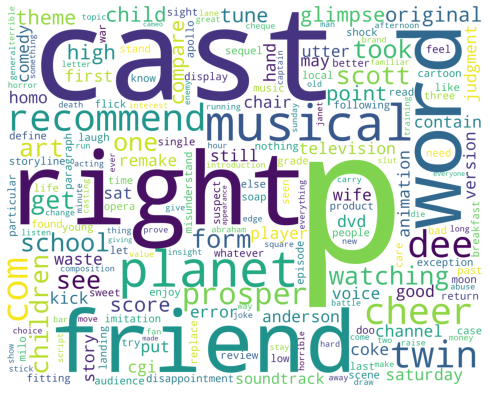

In [34]:
wordcloud_draw(w_features)

In [35]:
training_set = nltk.classify.apply_features(extract_features,tweets)
classifier = nltk.NaiveBayesClassifier.train(training_set)

KeyboardInterrupt: 